In [ ]:
import numpy as np
import cv2
import torch
from PIL import Image
from models import UNET, transform
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import os
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = UNET().to(device)
model.load_state_dict(torch.load(r"C:\Users\Mayank\Desktop\Lane_det\segmentation_torch_unet.pth", map_location=device, weights_only=True))
model.eval()



UNET(
  (encoder1): Encoder_block(
    (conv): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU()
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU()
    )
    (maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (encoder2): Encoder_block(
    (conv): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU()
      (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU()
    )
    (maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (encoder3): Encoder_block(
    (conv): Sequential(
      (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU()
      (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU()
    )
    (maxpool): MaxPool2d(kernel_size=2, stride=2, pad

In [ ]:
def ensure_rgb(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB) if image.shape[2] == 3 else image

def get_segmentation_mask(frame):
    try:
        frame_rgb = ensure_rgb(frame)
        img = Image.fromarray(frame_rgb)
        final_img = transform(img).unsqueeze(0).to(device)
        
        with torch.no_grad():
            mask = model(final_img)
        
        output = (mask > 0.5).squeeze(0).permute(1, 2, 0).cpu().numpy()
        count_0 = int(np.count_nonzero(output == 0)*0.85)
        
        print(count_0)
        iterator = 0
        plt.imshow(output,cmap="gray")
        plt.show()
        for i in range(256):
            for j in range(256):
                if output[255-i][255-j][0]==0:
                    iterator+=1
                    if iterator>=count_0:
                        output[255-i][255-j][0] = 1
        print(int(np.count_nonzero(output == 0)*0.6))
        plt.imshow(output,cmap="gray")
        plt.show()
        return output
    except Exception as e:
        print(f"Error in segmentation mask: {e}")
        return np.ones((frame.shape[0], frame.shape[1]))

# Adaptive Canny Edge Detection
def adaptive_canny(frame):
    threshold = cv2.threshold(frame, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[0]
    edges = cv2.Canny(frame, threshold * 0.75, threshold)
    print(edges.shape)
    plt.imshow(edges,cmap="gray")
    plt.show()
    return edges

# Dynamic Hough Line Transform
def detect_hough_lines(edges):
    try:
        # max(50, edges.shape[0] // 10)
        minLineLength = max(50, edges.shape[0] // 10)
        maxLineGap = max(20, edges.shape[1] // 20)
        # plt.imshow(cv2.HoughLinesP(edges, 1, np.pi / 180, 50, minLineLength=minLineLength, maxLineGap=maxLineGap),cmap="gray")
        # plt.show()
        return cv2.HoughLinesP(edges, 1, np.pi / 180, 50, minLineLength=minLineLength, maxLineGap=maxLineGap)
    except Exception as e:
        print(f"Error in Hough Line detection: {e}")
        return None

def draw_lines(frame, lines):

    """Draws Hough lines on the given frame"""
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]  # Extract points
            cv2.line(frame, (x1, y1), (x2, y2), (0, 255, 0), thickness=2)  # Draw line (Green)
    return frame


In [ ]:
def split_lines(lines, frame):
    left_lines, right_lines = [], []
    
    if lines is None or len(lines) == 0:
        print("Warning: No lines detected!")
        return left_lines, right_lines

    filtered_lines = []
    
    for line in lines:
        x1, y1, x2, y2 = line[0]
        if x2 - x1 == 0:  
            slope = float('inf')  
        else:
            slope = (y2 - y1) / (x2 - x1)

        # Ignore nearly horizontal lines (modify range as needed)
        if -0.2 < slope < 0.2:  # Previously was -0.1 < slope < 0.1
            continue  

        filtered_lines.append(line)

    # Find x-mid
    x_coords = [line[0][0] for line in filtered_lines]
    x_coords.sort()
    xmid = x_coords[len(x_coords) // 2]  

    for line in filtered_lines:
        x1, y1, x2, y2 = line[0]
        if x1 <= xmid:
            left_lines.append(line)
        else:
            right_lines.append(line)

    return left_lines, right_lines


In [ ]:
def cluster_lines(lines, k_val=1):
    if lines is None or len(lines) == 0:
        print(" Warning: No lines found for clustering!")
        return []  # Return an empty list instead of causing an error

    line_features = np.array([
        [(x1 + x2) / 2, (y1 + y2) / 2, np.arctan2(y2 - y1, x2 - x1)] 
        for [[x1, y1, x2, y2]] in lines
    ])
        
    # Ensure at least k clusters exist
    k_val = min(k_val, len(lines))  # Prevent k > number of data points

    kmeans = KMeans(n_clusters=k_val, random_state=42, n_init=10).fit(line_features)
    labels = kmeans.labels_

    clustered_lines = [
        [[int(np.mean([lines[i][0][j] for i in np.where(labels == idx)[0]])) for j in range(4)]]
        for idx in range(k_val)
    ]
    return clustered_lines

# def draw_lane_lines(image, lines, color=[255, 0, 0], thickness=12):
# 	"""
# 	Draw lines onto the input image.
# 		Parameters:
# 			image: The input test image (video frame in our case).
# 			lines: The output lines from Hough Transform.
# 			color (Default = red): Line color.
# 			thickness (Default = 12): Line thickness. 
# 	"""
# 	line_image = np.zeros_like(image)
# 	for line in lines:
# 		if line is not None:
# 			cv2.line(line_image, *line, color, thickness)
# 	return cv2.addWeighted(image, 1.0, line_image, 1.0, 0.0)


    # left_lane = cluster_lines(left_lines)
    # right_lane = cluster_lines(right_lines)

    # if not left_lane or not right_lane:  
    #     print("No lane detected after clustering. Returning unprocessed frame.")
    #     return frame_rgb  # Return original frame if clustering fails

    # clustered_lines = [left_lane[0], right_lane[0]]



In [ ]:
# def draw_lanes_and_arrow(frame, lines):
#     try:
#         if lines is None or len(lines) < 2:
#             print("Not enough lines to draw midline arrow!")
#             return frame

#         # Draw individual lane lines
#         for line in lines:
#             x1, y1, x2, y2 = line[0]
#             cv2.line(frame, (x1, y1), (x2, y2), (0, 255, 0), 3)

#         # Compute midline coordinates
#         x_start = (lines[0][0][0] + lines[1][0][0]) // 2  # (x1 of first + x1 of second) / 2
#         y_start = (lines[0][0][1] + lines[1][0][1]) // 2  # (y1 of first + y1 of second) / 2
#         x_end = (lines[0][0][2] + lines[1][0][2]) // 2  # (x2 of first + x2 of second) / 2
#         y_end = (lines[0][0][3] + lines[1][0][3]) // 2  # (y2 of first + y2 of second) / 2

#         # Draw the midline arrow
#         if not y_end>y_start:
#             cv2.arrowedLine(frame,(x_start, y_start),(x_end, y_end),(0, 0, 255), 3, tipLength=0.3)
#         else:
#             cv2.arrowedLine(frame,(x_end, y_end),(x_start, y_start),(0, 0, 255), 3, tipLength=0.3)

#         return frame  # Return modified frame

#     except Exception as e:
#         print(f"Error in drawing lanes: {e}")
#         return frame  # Return original frame if error

In [ ]:
def draw_lanes_and_arrow(frame, lines):
    try:
        if lines is None or len(lines) < 2:
            print("Not enough lines to draw midline arrow!")
            return frame

        # Draw individual lane lines
        for line in lines:
            x1, y1, x2, y2 = line[0]
            cv2.line(frame, (x1, y1), (x2, y2), (0, 255, 0), 3)

        # Compute midline starting point (centroid of first two lines)
        x_start = (lines[0][0][0] + lines[0][0][2] + lines[1][0][0] + lines[1][0][2]) // 4
        y_start = (lines[0][0][1] + lines[0][0][3] + lines[1][0][1] + lines[1][0][3]) // 4

        # Compute slopes of both lines
        def slope(x1, y1, x2, y2):
            if y2>y1 :
                return (y2 - y1) / (x2 - x1 + 1e-6)
            else :
                return -(y2 - y1) / (x2 - x1 + 1e-6)  # Avoid division by zero

        slope1 = slope(*lines[0][0])
        slope2 = slope(*lines[1][0])
        avg_slope = (slope1 + slope2) / 2

        # Compute lengths of both lines
        def line_length(x1, y1, x2, y2):
            return np.sqrt((x2 - x1) ** 2 + (y2 - y1) ** 2)

        len1 = line_length(*lines[0][0])
        len2 = line_length(*lines[1][0])
        arrow_length = max(len1, len2)  # Use the longer lane length

        # Compute end point using the average slope and length
        dx = int(250 / np.sqrt(1 + avg_slope ** 2))
        dy = int(avg_slope * dx)

        x_end = x_start + dx
        y_end = y_start + dy

        # Adjust direction based on y_start and y_end
        if y_start < y_end:
            cv2.arrowedLine(frame, (x_end, y_end), (x_start, y_start), (0, 0, 255), 3, tipLength=0.3)
        else:
            cv2.arrowedLine(frame, (x_start, y_start), (x_end, y_end), (0, 0, 255), 3, tipLength=0.3)

        return frame  # Return modified frame

    except Exception as e:
        print(f"Error in drawing lanes: {e}")
        return frame  # Return original frame if error

In [ ]:
def process_video(input_path):


    """Reads a video, processes each frame, and saves the output video in MP4 format."""
    
    # Open the input video
    cap = cv2.VideoCapture(input_path)
    if not cap.isOpened():
        print("Error: Could not open input video.")
        return
    
    # Get video properties
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)  
    print(fps)
    # Ensure FPS is valid
    if fps <= 0 or fps is None:
        fps = 5  # Default to 30 FPS if not detected

    # Define the codec and create VideoWriter object (H.264 encoding for MP4)
    # fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Try 'mp4v' instead of 'avc1'
    # out = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))


    # print(f"Processing video: {input_path}")
    # print(f"Output will be saved as: {output_path} (FPS: {fps}, Resolution: {frame_width}x{frame_height})")

    # frame_count = 0

    # while cap.isOpened():
    #     ret, frame = cap.read()
    #     if not ret:
    #         print(f"Processed {frame_count} frames. End of video reached.")
    #         break  # Stop when video ends

    #     # 🔹 Try processing the frame
    #     try:
    #         processed_frame = process_frame(frame)  # Apply processing if possible
    #         if processed_frame is None:
    #             print(f"Warning: Processed frame is None at frame {frame_count}. Writing original frame instead.")
    #             processed_frame = frame  # Use the original frame if processing fails

    #     except Exception as e:
    #         print(f"Error processing frame {frame_count}: {e}. Writing original frame instead.")
    #         processed_frame = frame  # Use the original frame if processing crashes

    #     out.write(processed_frame)  # Write frame to output
    #     frame_count += 1

    # cap.release()
    # out.release()

    # print("Processing complete. Video saved.")

    # # Handle GUI-related OpenCV issues
    # try:
    #     cv2.destroyAllWindows()
    # except cv2.error:
    #     print("Skipping cv2.destroyAllWindows() due to missing GUI support.")

    # # Process video frame by frame
    frame_count = 0
    while True:
        ret, frame = cap.read()
        if not ret:
            print("End of video reached or error reading frame.")
            break

        processed_frame = process_frame(frame)  # Apply processing
        # out.write(processed_frame)  # Save processed frame
        
        # frame_count += 1
        # if frame_count % 50 == 0:
        #     print(f"Processed {frame_count} frames...")

    # Release resources
    # cap.release()
    # out.release()
    # cv2.destroyAllWindows()
    
    # print("✅ Video processing complete!")


In [56]:
def draw_lanes_and_arrow(frame, lines):
    try:
        if lines is None or len(lines) < 2:
            print("Not enough lines to draw midline arrow!")
            return frame

        # Draw individual lane lines
        for line in lines:
            x1, y1, x2, y2 = line[0]
            cv2.line(frame, (x1, y1), (x2, y2), (0, 255, 0), 3)

        # Compute midline starting point (centroid of first two lines)
        x_start = (lines[0][0][0] + lines[0][0][2] + lines[1][0][0] + lines[1][0][2]) // 4
        y_start = (lines[0][0][1] + lines[0][0][3] + lines[1][0][1] + lines[1][0][3]) // 4

        # Compute slopes of both lines
        def slope(x1, y1, x2, y2):
            if y2>y1 :
                return (y2 - y1) / (x2 - x1 + 1e-6)
            else :
                return -(y2 - y1) / (x2 - x1 + 1e-6)  # Avoid division by zero

        slope1 = slope(*lines[0][0])
        slope2 = slope(*lines[1][0])
        avg_slope = (slope1 + slope2) / 2

        # Compute lengths of both lines
        def line_length(x1, y1, x2, y2):
            return np.sqrt((x2 - x1) ** 2 + (y2 - y1) ** 2)

        len1 = line_length(*lines[0][0])
        len2 = line_length(*lines[1][0])
        arrow_length = max(len1, len2)  # Use the longer lane length

        # Compute end point using the average slope and length
        dx = int(250 / np.sqrt(1 + avg_slope ** 2))
        dy = int(avg_slope * dx)

        x_end = x_start + dx
        y_end = y_start + dy

        # Adjust direction based on y_start and y_end
        if y_start < y_end:
            cv2.arrowedLine(frame, (x_end, y_end), (x_start, y_start), (0, 0, 255), 3, tipLength=0.3)
        else:
            cv2.arrowedLine(frame, (x_start, y_start), (x_end, y_end), (0, 0, 255), 3, tipLength=0.3)

        return frame  # Return modified frame

    except Exception as e:
        print(f"Error in drawing lanes: {e}")
        return frame  # Return original frame if error

In [ ]:
# def average_slope_intercept(lines):
# 	print(lines)
# 	left_lines = [] #(slope, intercept)
# 	left_weights = [] #(length,)
# 	right_lines = [] #(slope, intercept)
# 	right_weights = [] #(length,)
# 	print(lines)
# 	for line in lines:
# 		x1, y1, x2, y2 = line[0]
# 		if x1 == x2:
# 			continue
# 		# calculating slope of a line
# 		slope = (y2 - y1) / (x2 - x1)
# 		# calculating intercept of a line
# 		intercept = y1 - (slope * x1)
# 		# calculating length of a line
# 		length = np.sqrt(((y2 - y1) ** 2) + ((x2 - x1) ** 2))
# 		# slope of left lane is negative and for right lane slope is positive
# 		if slope < 0:
# 			left_lines.append((slope, intercept))
# 			left_weights.append((length))
# 		else:
# 			right_lines.append((slope, intercept))
# 			right_weights.append((length))
# 	left_lane = np.dot(left_weights, left_lines) / np.sum(left_weights)if len(left_weights) > 0 else None
# 	right_lane = np.dot(right_weights, right_lines) / np.sum(right_weights) if len(right_weights) > 0 else None
# 	return left_lane, right_lane

# def pixel_points(y1, y2, line):
# 	"""
# 	Converts the slope and intercept of each line into pixel points.
# 		Parameters:
# 			y1: y-value of the line's starting point.
# 			y2: y-value of the line's end point.
# 			line: The slope and intercept of the line.
# 	"""
# 	if line is None:
# 		return None
# 	slope, intercept = line
# 	x1 = int((y1 - intercept)/slope)
# 	x2 = int((y2 - intercept)/slope)
# 	y1 = int(y1)
# 	y2 = int(y2)
# 	return ((x1, y1), (x2, y2))

# def calculate_lane_lines(image, lines):
# 	"""
# 	Create full lenght lines from pixel points.
# 		Parameters:
# 			image: The input test image.
# 			lines: The output lines from Hough Transform.
# 	"""
# 	print(lines.shape)
# 	left_lane, right_lane = average_slope_intercept(lines)
# 	y1 = image.shape[0]
# 	y2 = y1 * 0.6
# 	left_line = pixel_points(y1, y2, left_lane)
# 	right_line = pixel_points(y1, y2, right_lane)
# 	return left_line, right_line

# Draw lanes


def process_frame(frame):

    frame_rgb = ensure_rgb(frame)
    gray = cv2.cvtColor(frame_rgb, cv2.COLOR_BGR2GRAY)
# Apply bilateral filter
    d = 11              # Diameter of the pixel neighborhood
    sigma_color = 100    # Intensity variance (range kernel)
    sigma_space = 75    # Spatial variance (spatial kernel)
    blurred_frame = cv2.bilateralFilter(gray, d, sigma_color, sigma_space)

    mask = get_segmentation_mask(frame)
    edges = adaptive_canny(blurred_frame)
    mask_resized = cv2.resize(mask.astype(np.uint8), (edges.shape[1], edges.shape[0]), interpolation=cv2.INTER_NEAREST)

    inverted_mask = 1 - mask_resized
    edges = edges * inverted_mask
    # plt.imshow(edges,cmap="gray")
    # plt.show()
    lines = detect_hough_lines(edges)
    print(lines)
    plt.imshow(draw_lines(frame,lines))
    plt.show()
    if lines is None or len(lines) == 0:  
        print("No lines detected. Returning unprocessed frame.")
        return frame_rgb  # Return the original frame

    left_lines, right_lines = split_lines(lines, (edges.shape[1])//2)

    # Handle missing lane lines
    if not left_lines and right_lines:
        print("No left lines found. Using right lines for both lanes.")
        left_lines = right_lines
    elif not right_lines and left_lines:
        print("No right lines found. Using left lines for both lanes.")
        right_lines = left_lines
    elif not left_lines and not right_lines:
        print("No lane lines detected. Returning unprocessed frame.")
        return frame_rgb  # Return the original frame if no lanes detected

    left_lane = cluster_lines(left_lines)
    right_lane = cluster_lines(right_lines)

    if not left_lane or not right_lane:  
        print("No lane detected after clustering. Returning unprocessed frame.")
        return frame_rgb  # Return original frame if clustering fails

    clustered_lines = [left_lane[0], right_lane[0]]
    return draw_lanes_and_arrow(frame_rgb, clustered_lines)


def trial(frame):
    plt.imshow(process_frame(frame))
    plt.show()

# for path in os.listdir("./test_images"):
#     Img = cv2.imread(os.path.join("test_images",path))
#     trial(Img)


30.057014840250872
25640


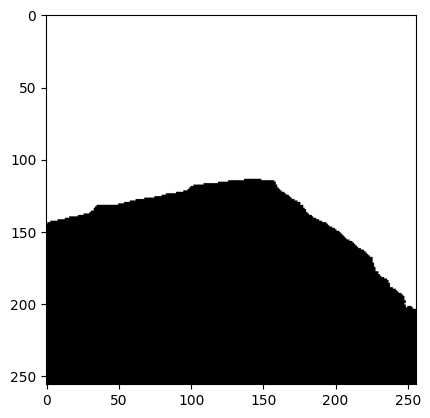

15383


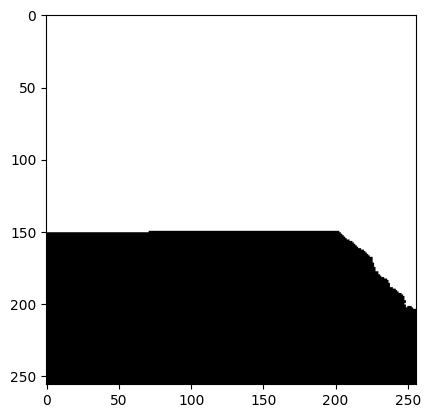

(850, 478)


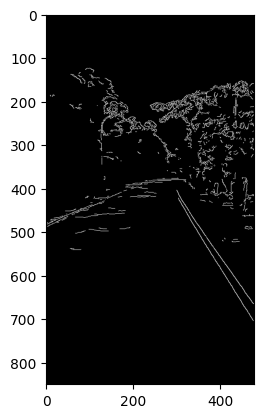

[[[348 500 474 702]]

 [[359 499 459 641]]

 [[348 499 476 704]]]


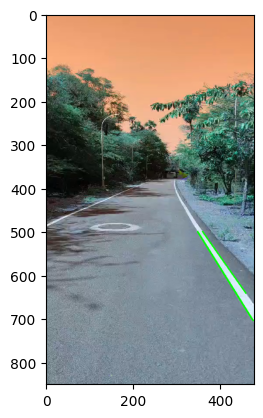

25605


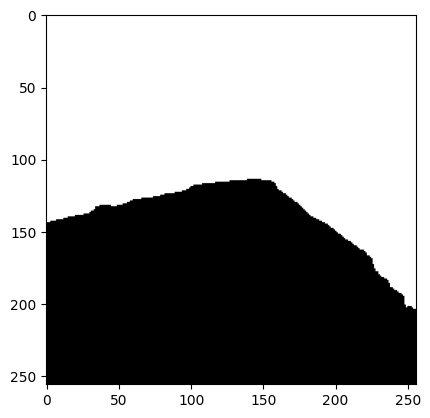

15362


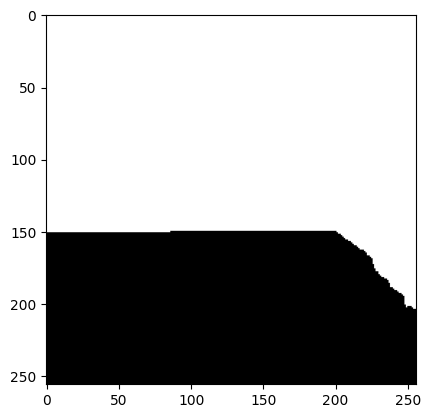

(850, 478)


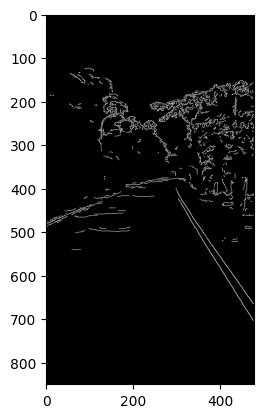

[[[348 500 475 703]]

 [[360 499 459 641]]

 [[348 499 476 703]]]


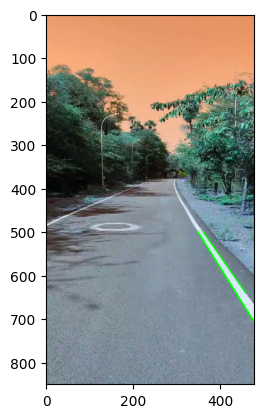

25728


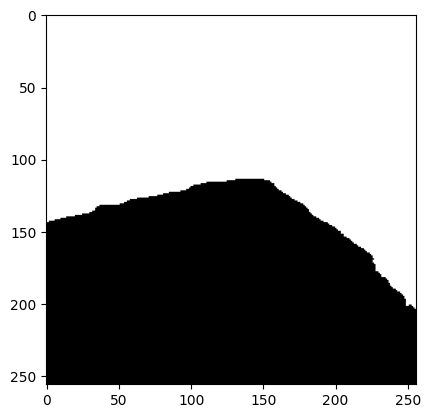

15436


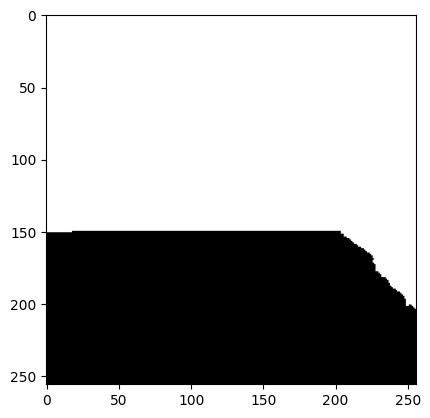

(850, 478)


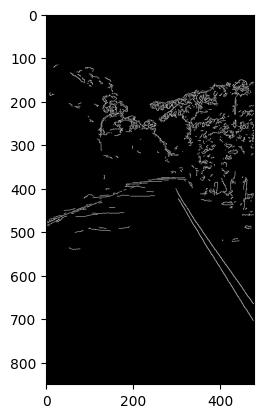

[[[348 499 475 703]]

 [[359 499 459 642]]

 [[351 505 474 702]]

 [[360 499 444 619]]]


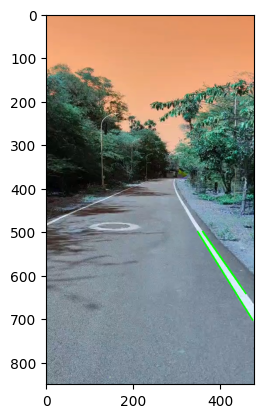

25757


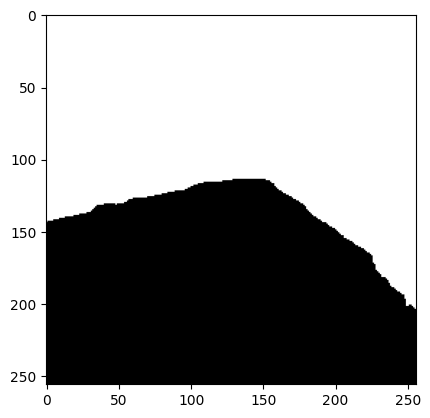

15453


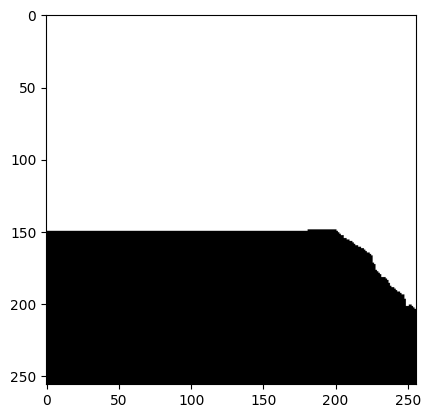

(850, 478)


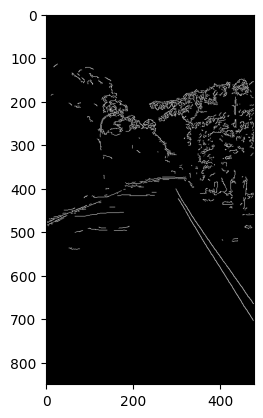

[[[345 495 475 703]]

 [[346 495 476 703]]

 [[357 496 463 647]]

 [[357 495 444 619]]]


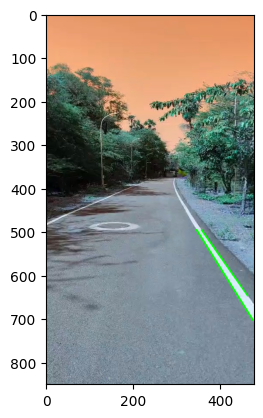

No right lines found. Using left lines for both lanes.
25796


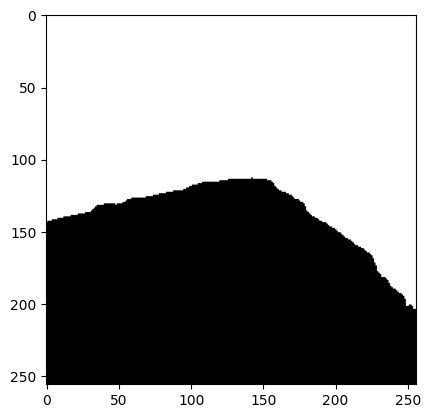

15477


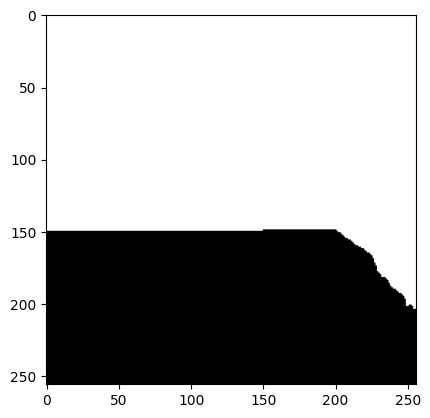

(850, 478)


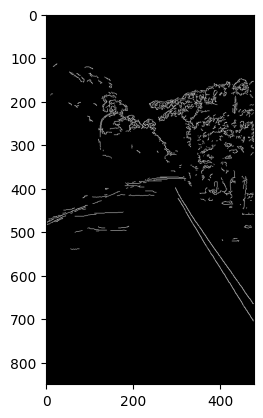

[[[345 495 476 704]]

 [[357 496 459 642]]]


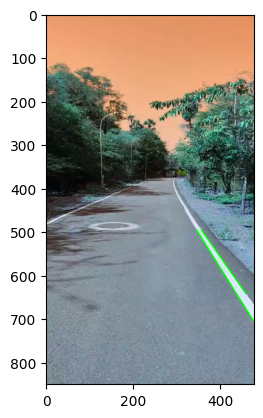

No right lines found. Using left lines for both lanes.
25818


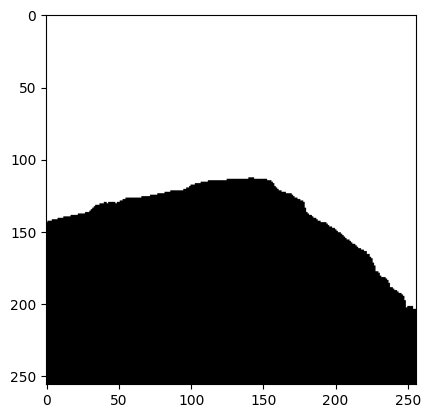

15490


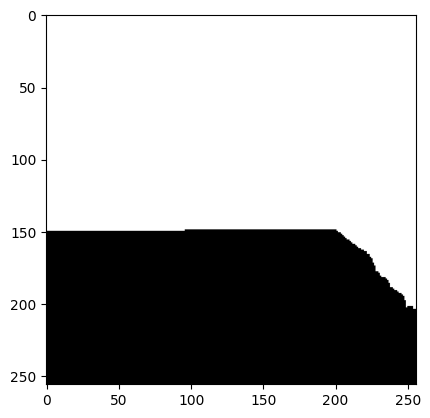

(850, 478)


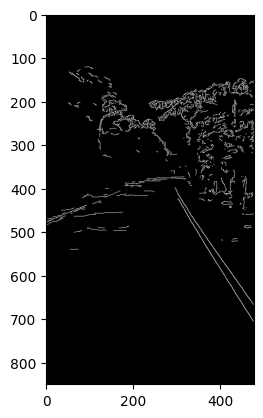

[[[345 495 476 705]]

 [[357 497 463 649]]

 [[352 508 475 705]]]


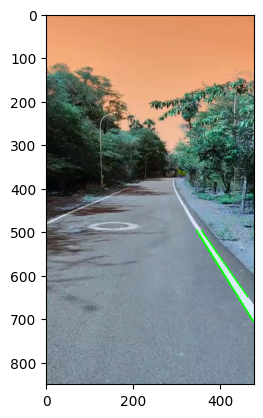

25811


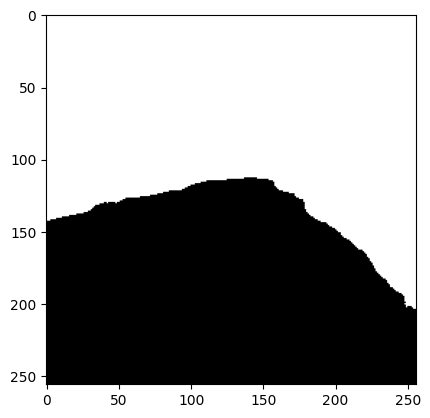

15486


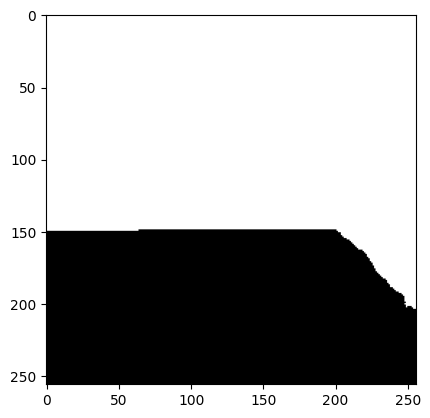

(850, 478)


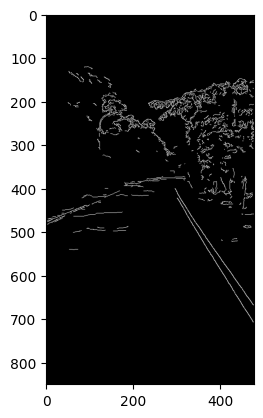

[[[344 496 476 707]]

 [[355 495 463 649]]

 [[356 497 463 650]]]


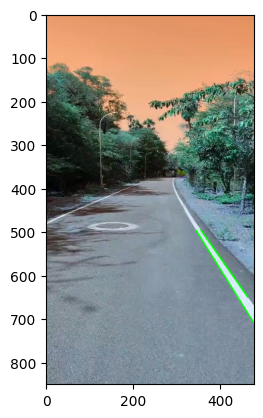

25764


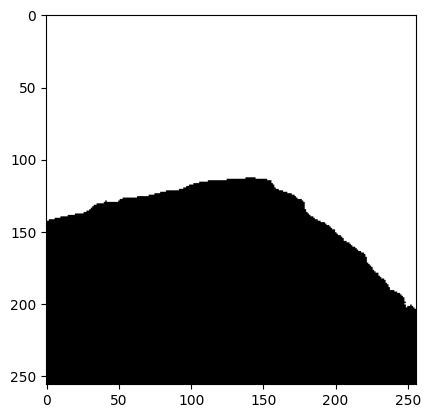

15457


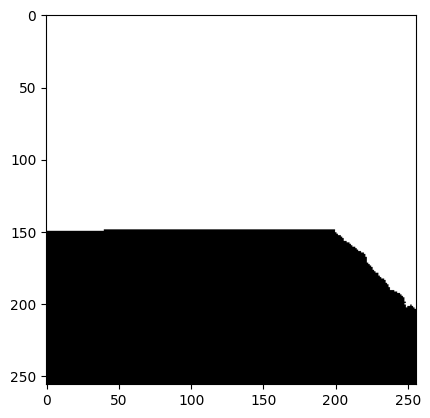

(850, 478)


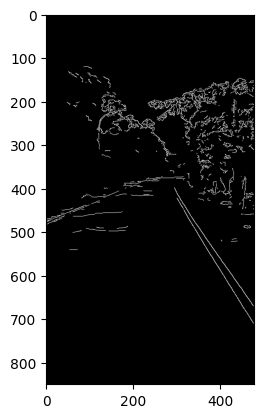

[[[343 495 476 709]]

 [[354 495 463 651]]

 [[353 513 476 710]]

 [[364 511 432 608]]]


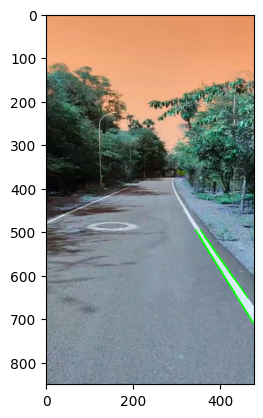

25666


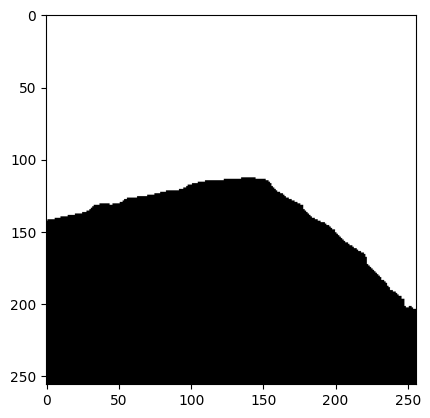

15399


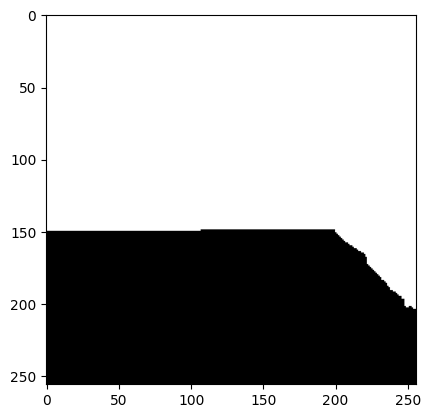

(850, 478)


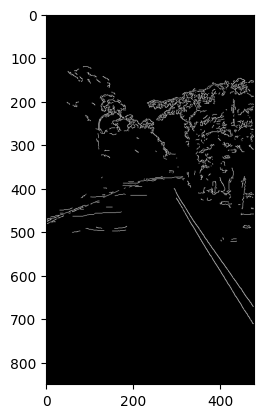

[[[353 495 440 620]]

 [[344 500 475 711]]

 [[355 499 440 621]]]


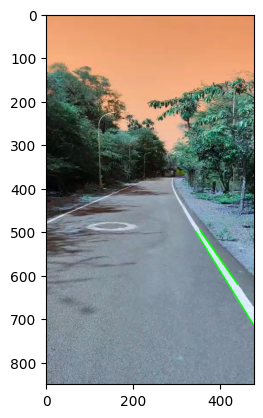

25625


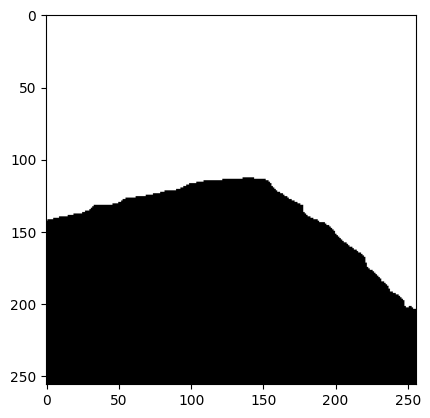

15374


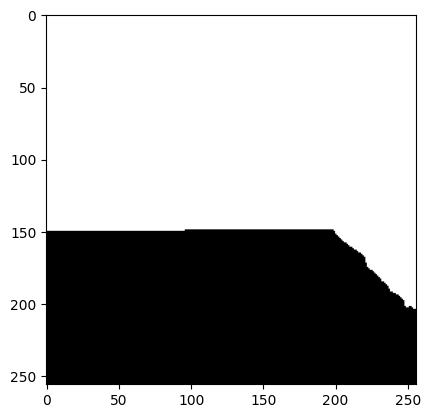

(850, 478)


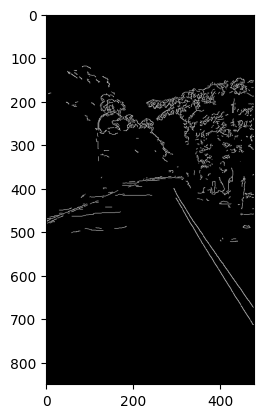

[[[340 495 476 713]]

 [[347 507 475 713]]

 [[352 495 440 621]]

 [[353 498 442 625]]]


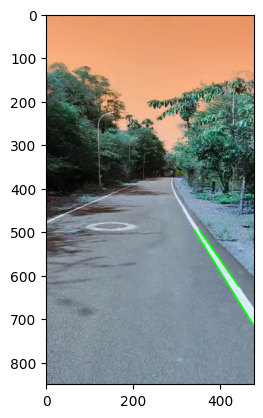

25498


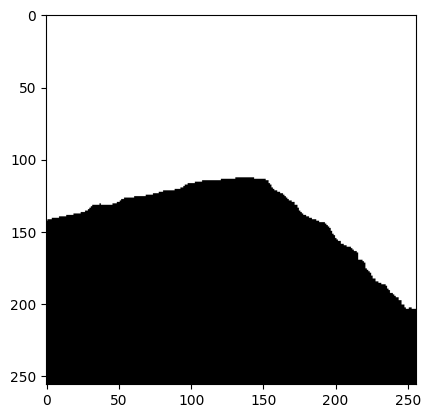

15298


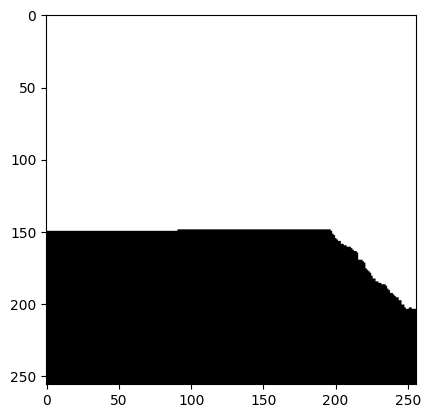

(850, 478)


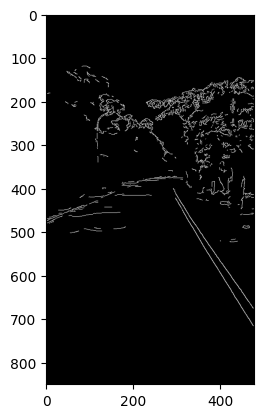

[[[347 509 475 715]]

 [[339 495 477 716]]

 [[350 495 420 595]]

 [[353 500 420 596]]]


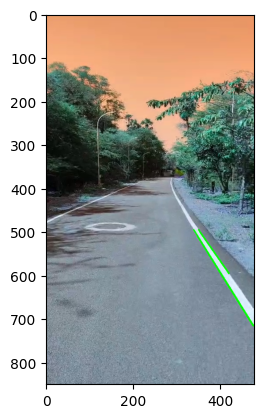

25471


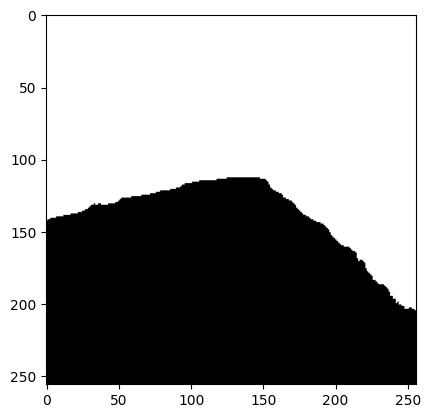

15282


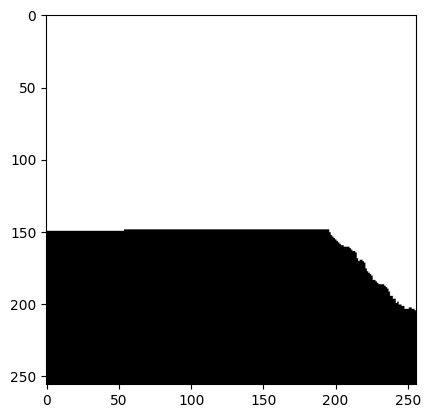

(850, 478)


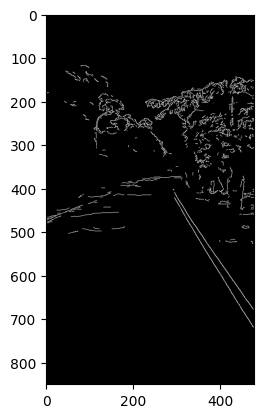

[[[340 500 476 719]]

 [[348 495 436 621]]

 [[359 532 475 718]]]


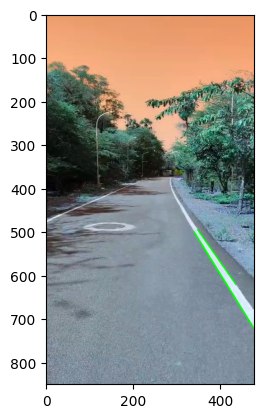

25538


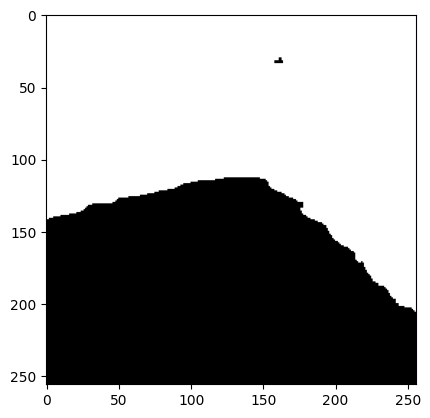

15322


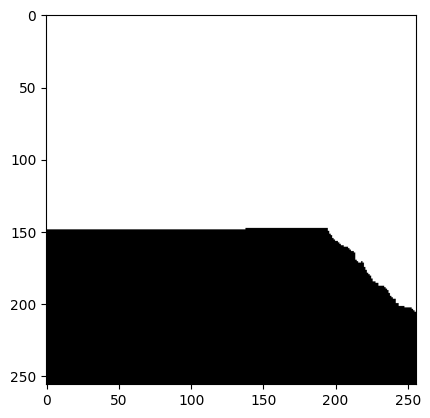

(850, 478)


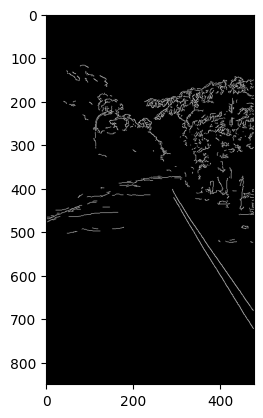

[[[349 518 476 722]]

 [[344 509 477 722]]

 [[350 500 420 601]]]


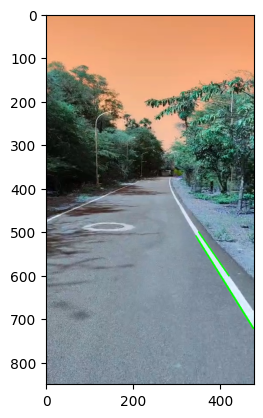

25620


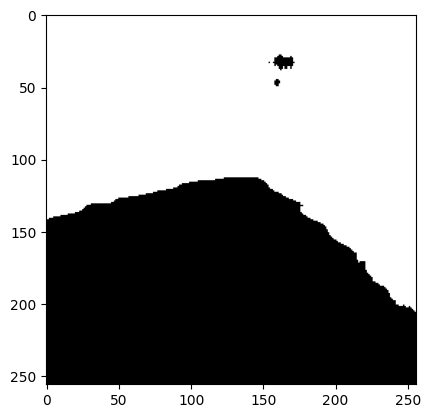

15371


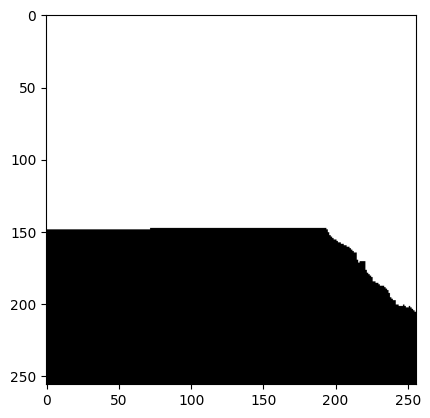

(850, 478)


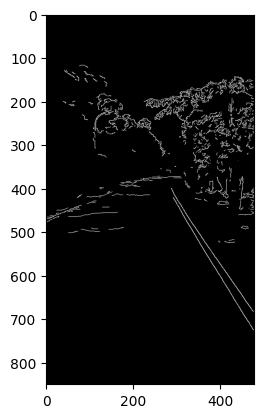

[[[347 517 476 724]]

 [[344 493 420 602]]

 [[333 493 429 648]]

 [[357 513 442 635]]

 [[406 613 476 725]]]


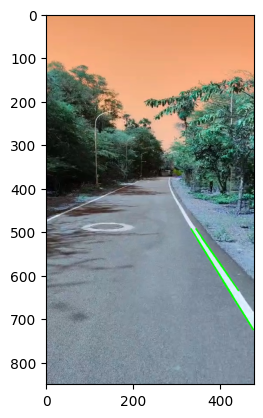

25519


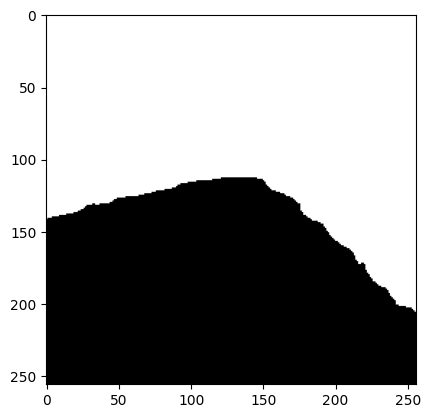

15310


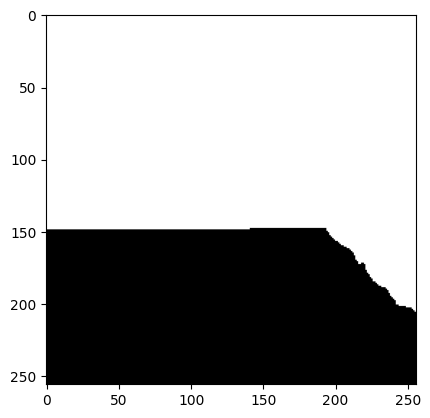

(850, 478)


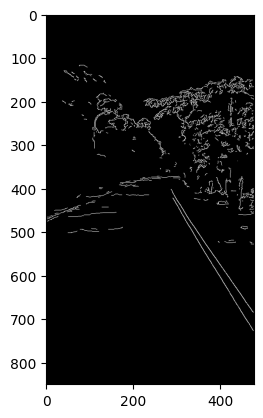

[[[344 514 477 727]]

 [[343 492 410 591]]

 [[332 493 417 630]]

 [[373 562 475 726]]]


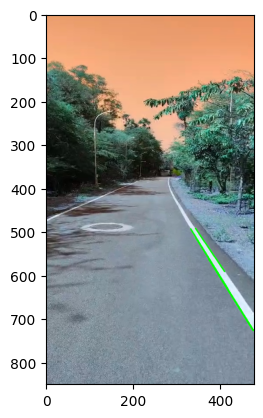

25573


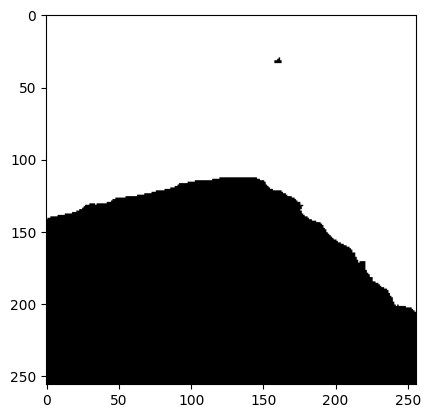

15343


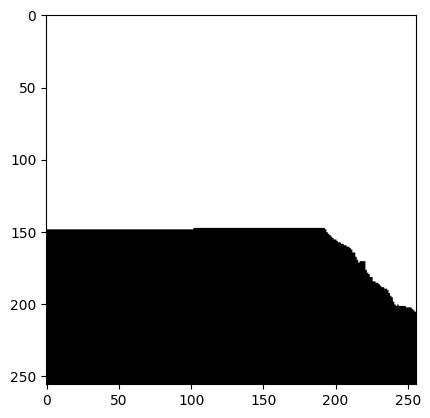

(850, 478)


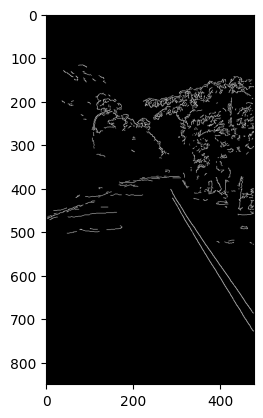

[[[343 514 476 728]]

 [[343 495 442 637]]

 [[372 562 475 727]]

 [[331 493 422 640]]]


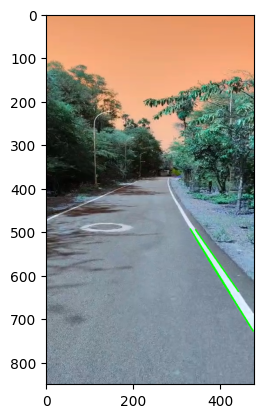

25396


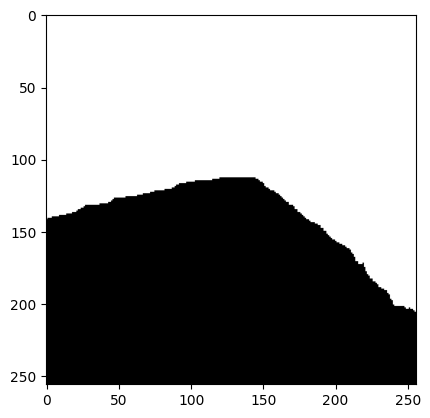

15237


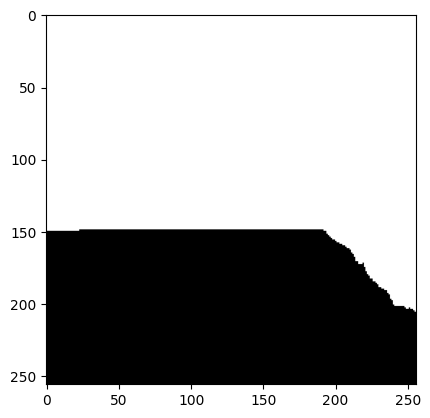

(850, 478)


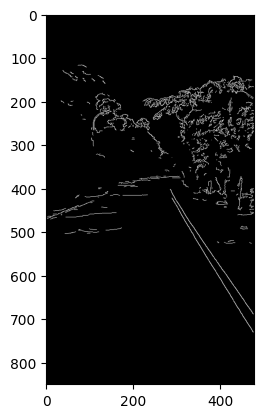

[[[345 520 476 730]]

 [[342 495 406 589]]

 [[332 497 428 652]]

 [[343 495 427 619]]]


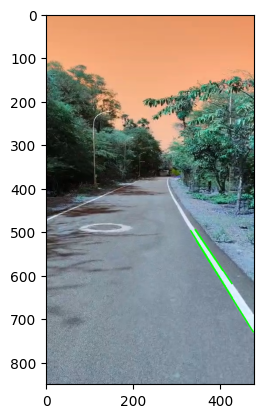

25495


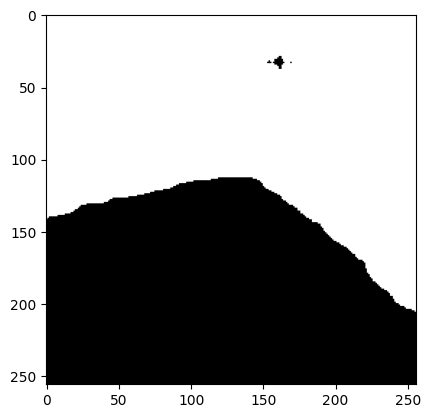

15296


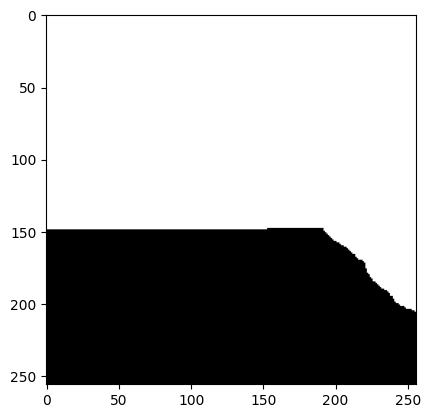

(850, 478)


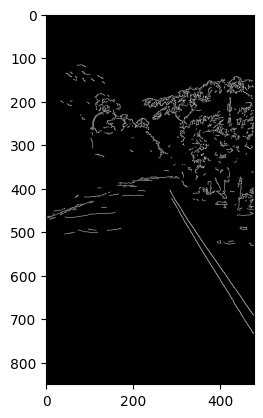

[[[331 498 427 653]]

 [[356 519 476 691]]

 [[360 547 476 733]]

 [[339 493 448 649]]]


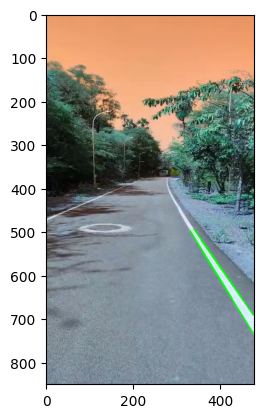

25523


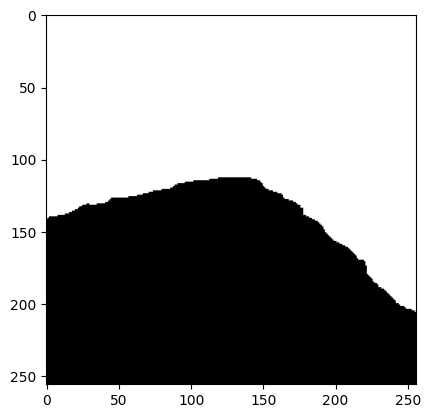

15313


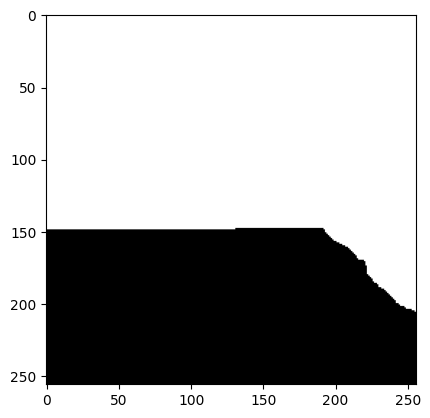

(850, 478)


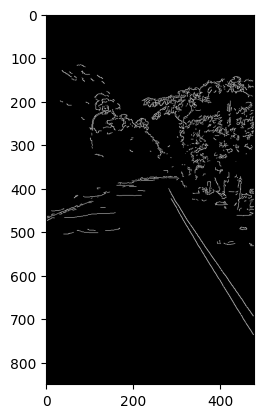

[[[340 516 477 736]]

 [[344 503 477 693]]

 [[327 492 453 701]]

 [[337 492 441 641]]

 [[364 533 476 693]]]


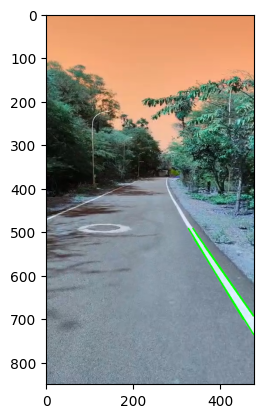

25460


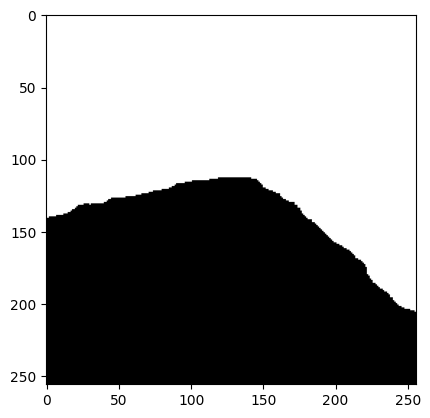

15275


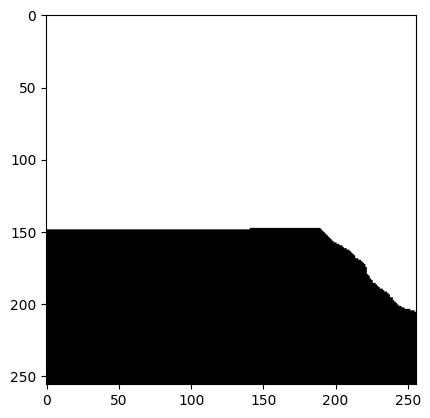

(850, 478)


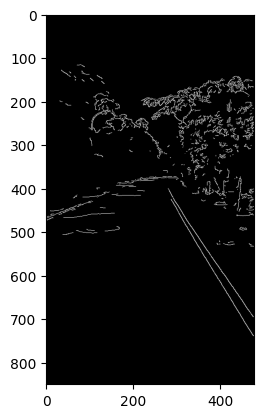

[[[351 515 448 654]]

 [[326 492 459 713]]

 [[392 601 473 735]]

 [[325 492 394 607]]

 [[367 539 476 695]]

 [[337 494 441 643]]]


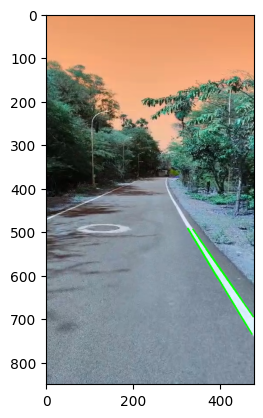

25419


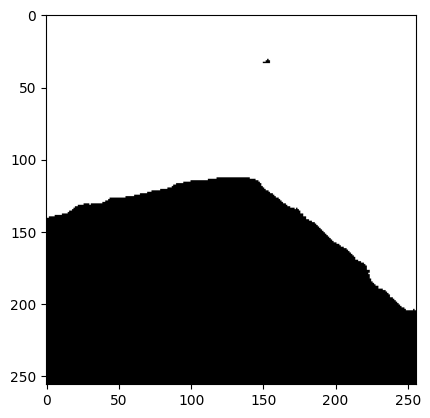

15250


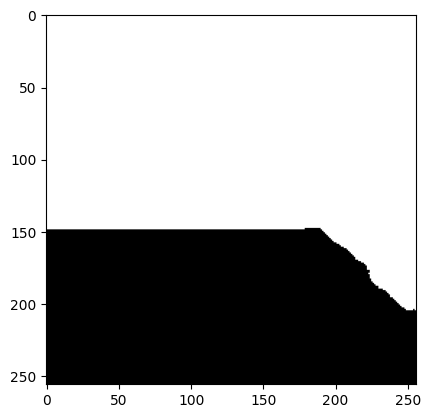

(850, 478)


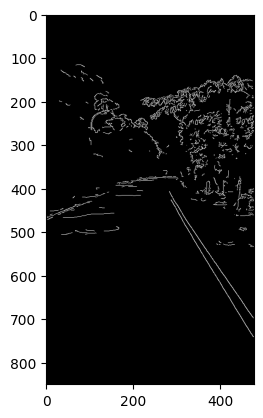

[[[326 495 470 733]]

 [[347 511 455 666]]

 [[327 497 413 640]]

 [[369 544 477 698]]

 [[398 613 475 740]]]


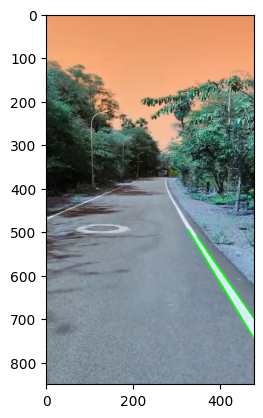

25491


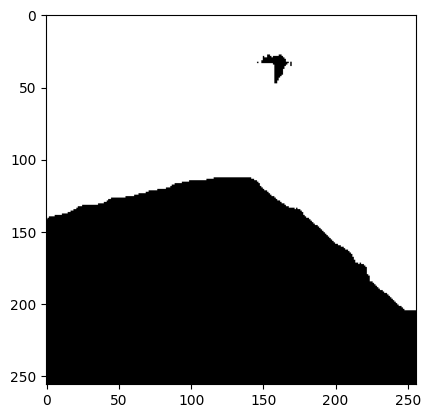

15294


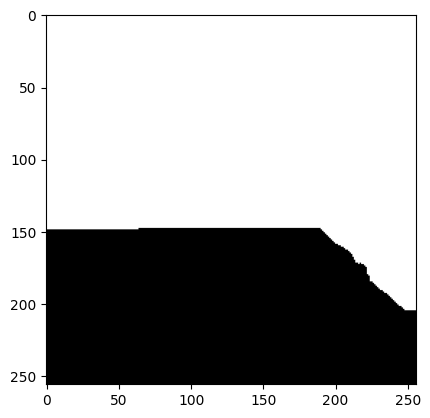

(850, 478)


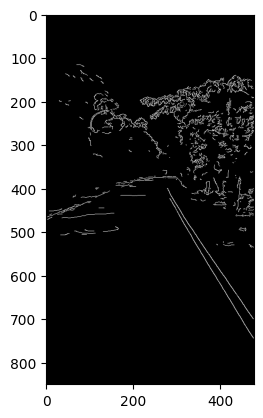

[[[334 492 432 637]]

 [[323 492 469 734]]

 [[409 601 475 699]]]


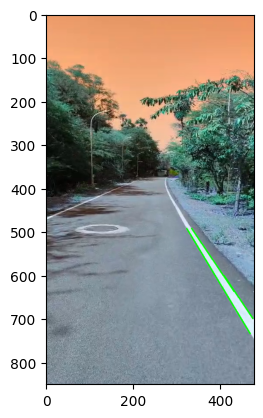

25543


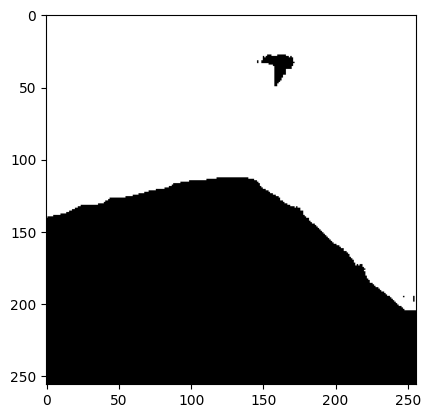

15325


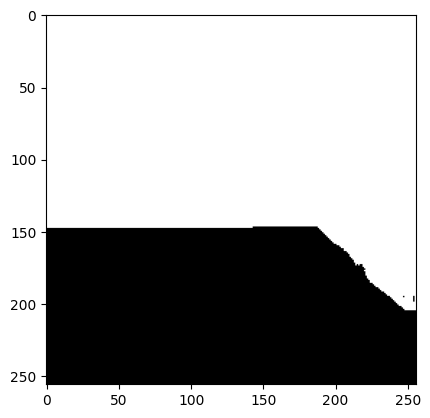

(850, 478)


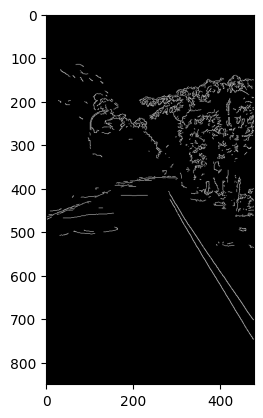

[[[375 554 474 700]]

 [[325 498 462 726]]

 [[320 489 475 746]]

 [[333 491 398 590]]]


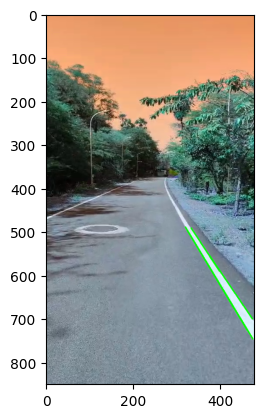

25536


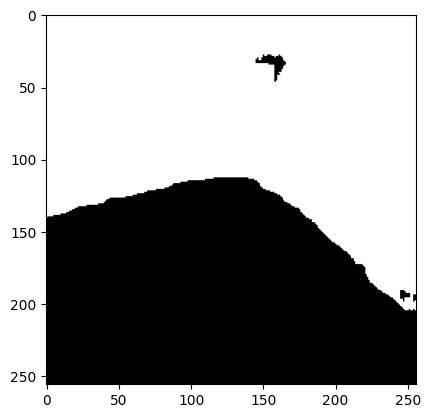

15321


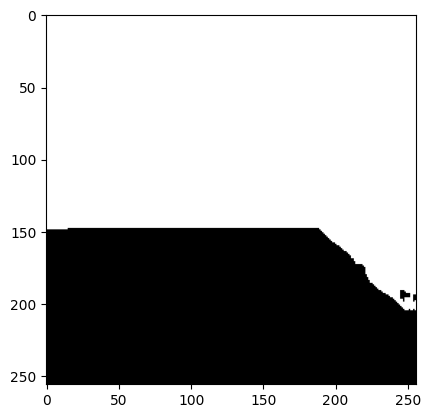

(850, 478)


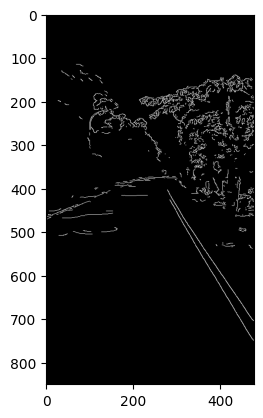

[[[324 498 473 746]]

 [[332 492 474 702]]

 [[321 492 475 748]]

 [[390 577 476 704]]

 [[332 493 430 638]]]


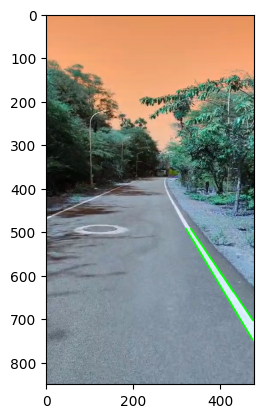

25368


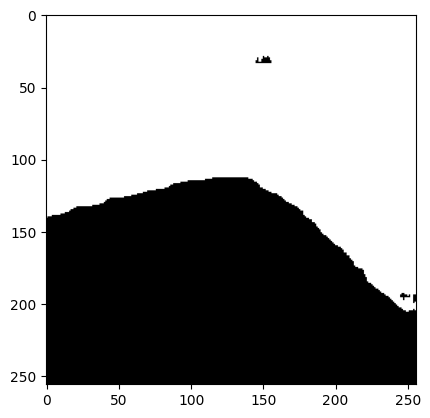

15220


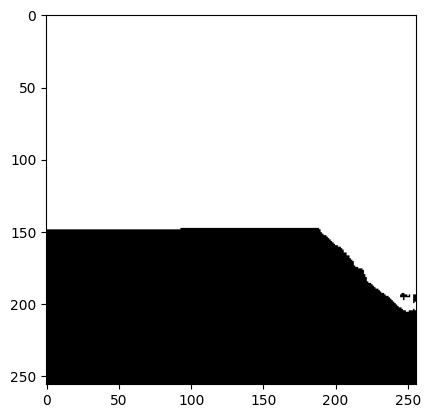

(850, 478)


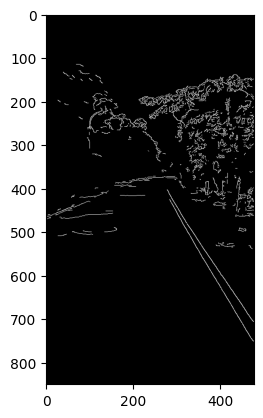

[[[331 492 475 705]]

 [[320 492 476 751]]

 [[325 501 474 749]]]


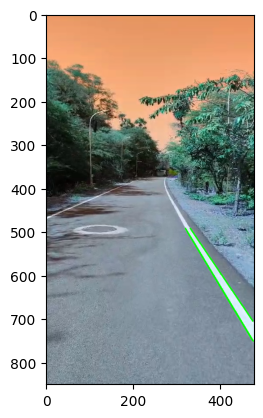

25360


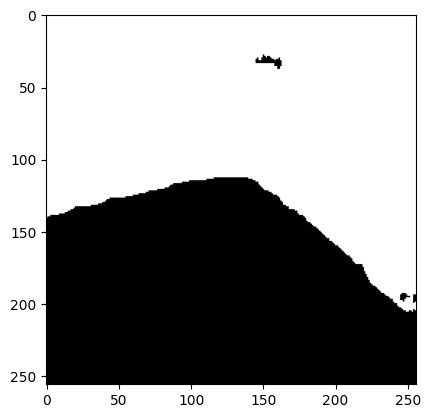

15215


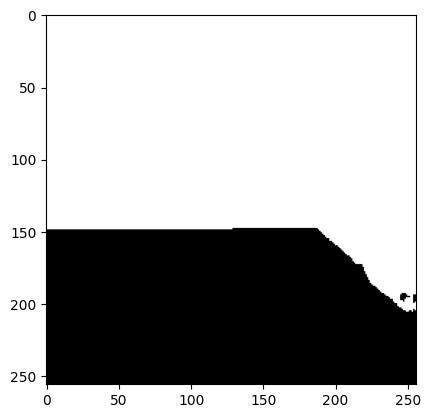

(850, 478)


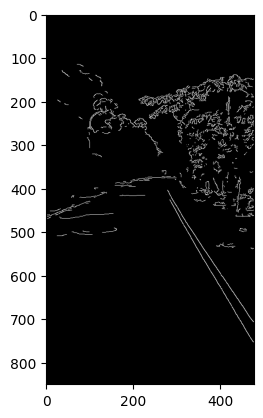

[[[343 532 475 752]]

 [[331 492 476 707]]

 [[322 495 454 716]]]


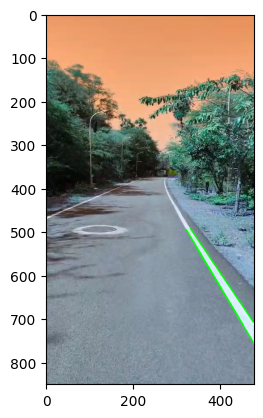

25310


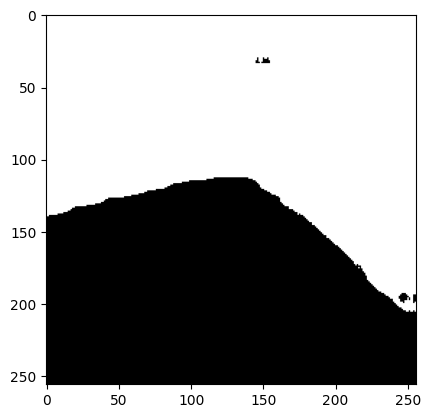

15185


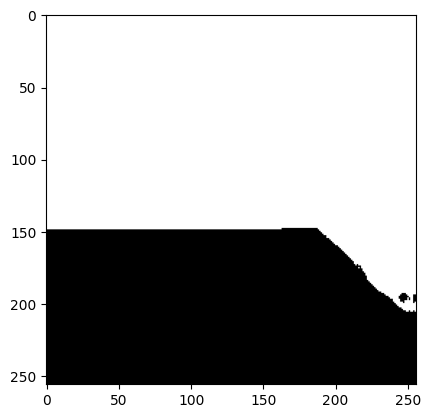

(850, 478)


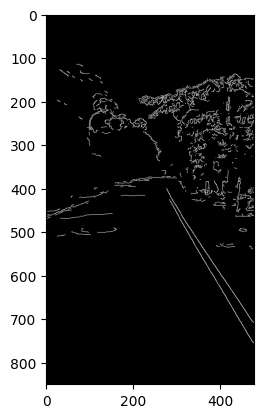

[[[341 530 476 755]]

 [[331 493 476 708]]

 [[332 514 476 754]]

 [[336 501 475 707]]]


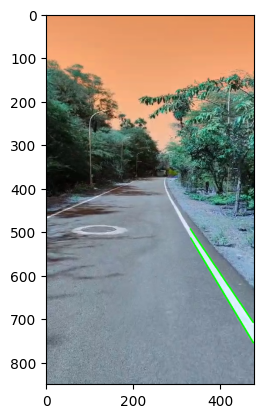

25521


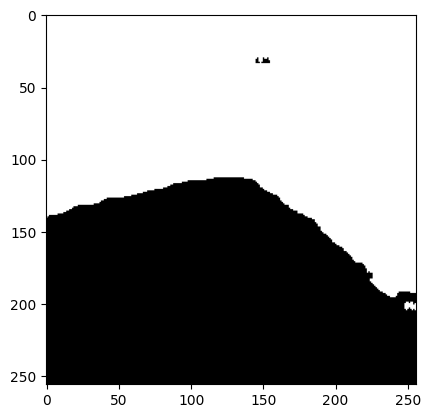

15312


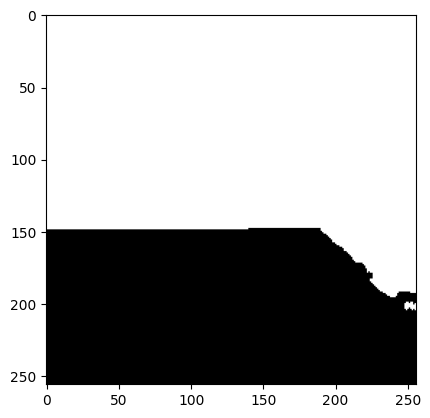

(850, 478)


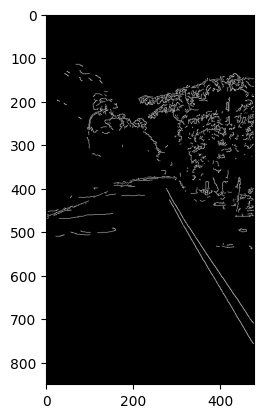

[[[330 492 476 709]]

 [[328 508 454 719]]

 [[345 538 476 757]]

 [[350 523 476 710]]]


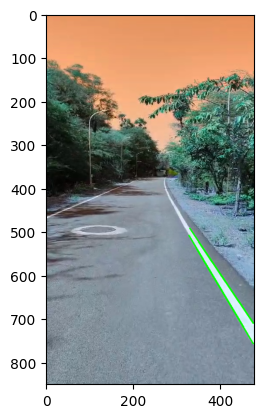

25448


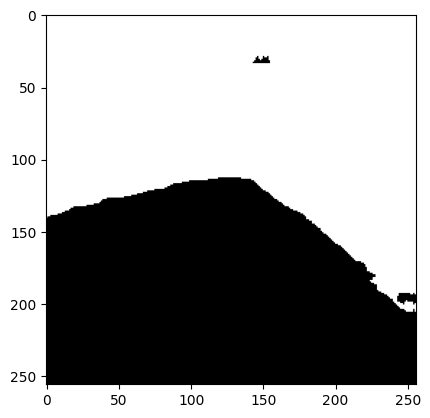

15268


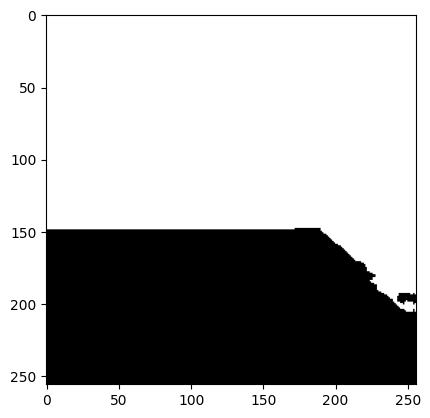

(850, 478)


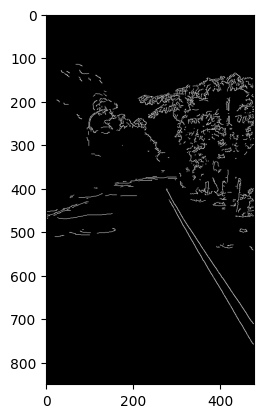

[[[355 532 476 711]]

 [[349 546 476 758]]

 [[324 502 433 685]]

 [[329 492 477 711]]]


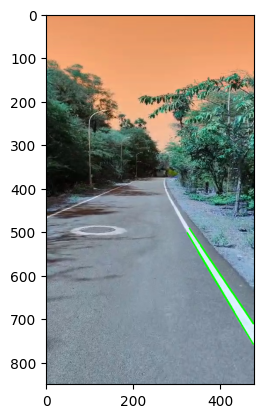

25491


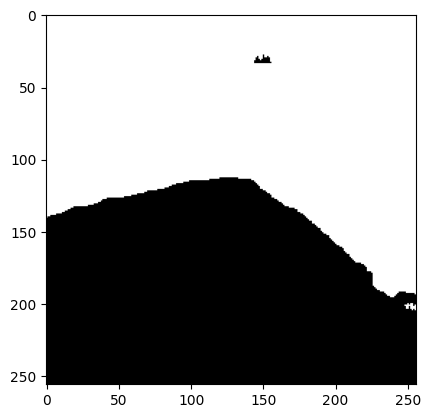

15294


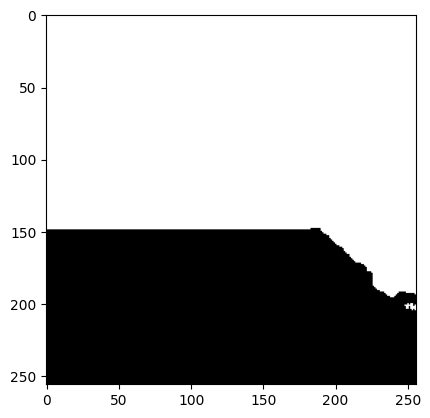

(850, 478)


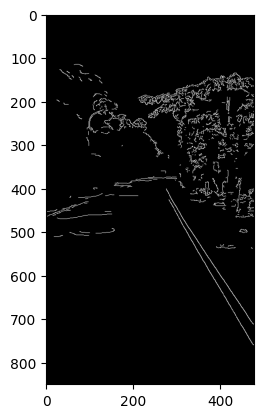

[[[331 495 477 712]]

 [[333 519 435 690]]

 [[348 522 476 712]]

 [[349 547 476 759]]]


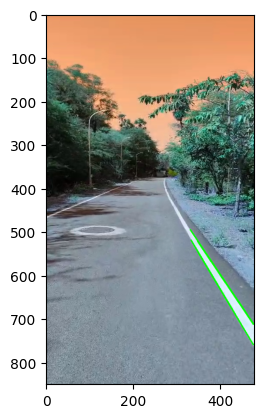

25448


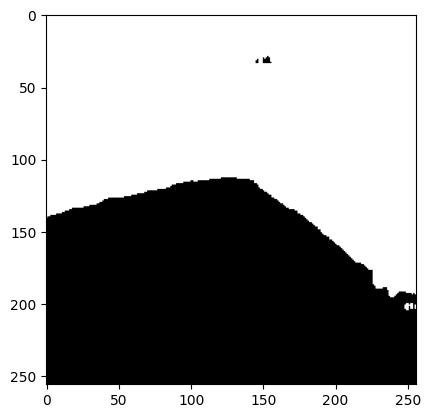

15268


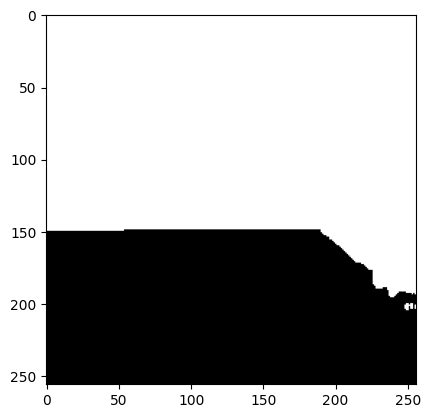

(850, 478)


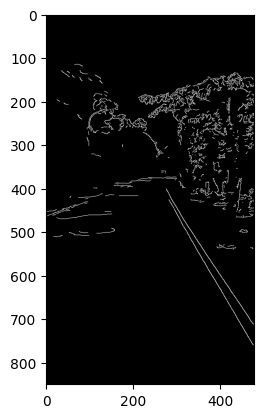

[[[341 511 476 712]]

 [[333 519 437 693]]

 [[359 564 461 734]]

 [[416 660 475 759]]]


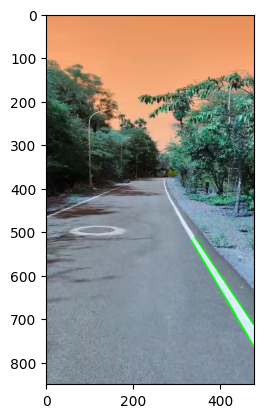

25536


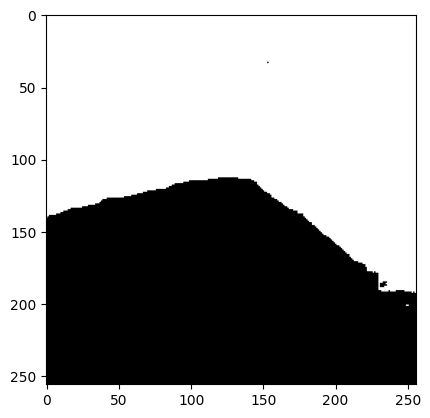

15321


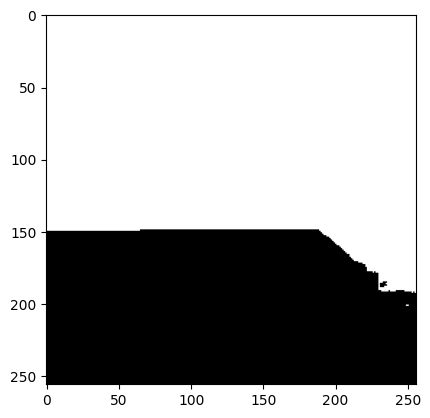

(850, 478)


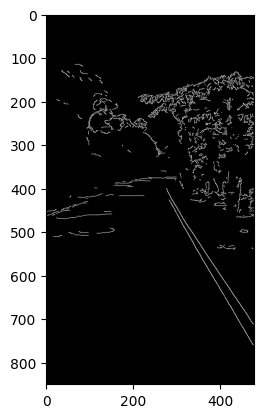

[[[357 535 476 712]]

 [[339 529 436 691]]

 [[345 540 477 760]]

 [[331 495 477 712]]]


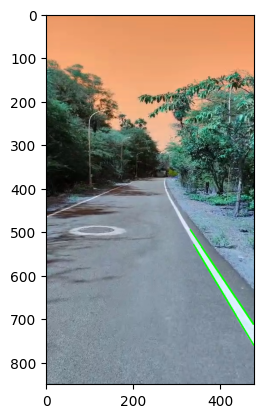

25668


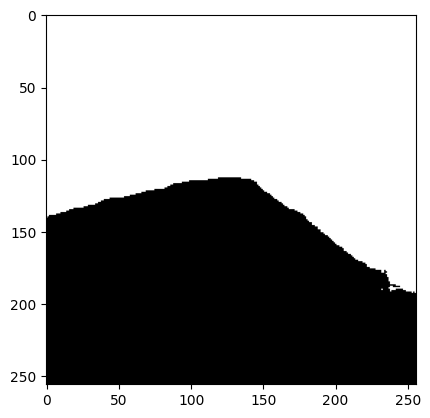

15400


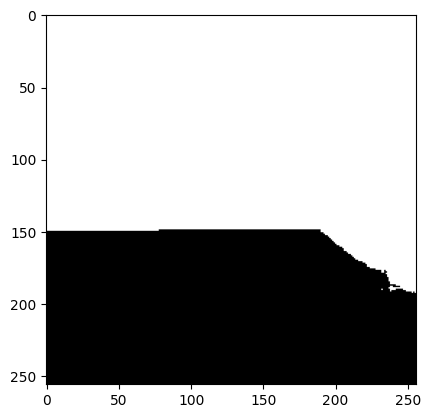

(850, 478)


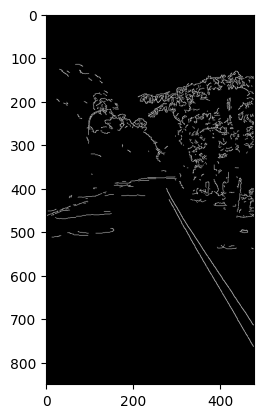

[[[321 495 476 763]]

 [[332 497 460 688]]

 [[367 551 476 714]]

 [[322 499 406 644]]]


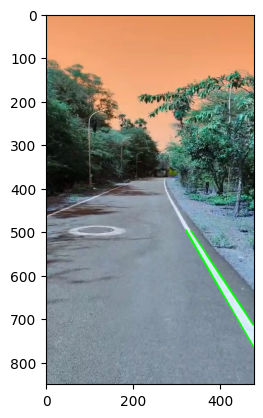

25626


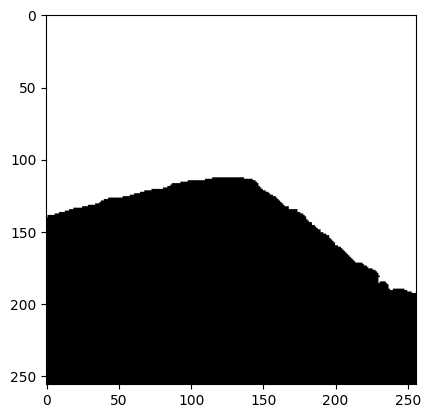

15375


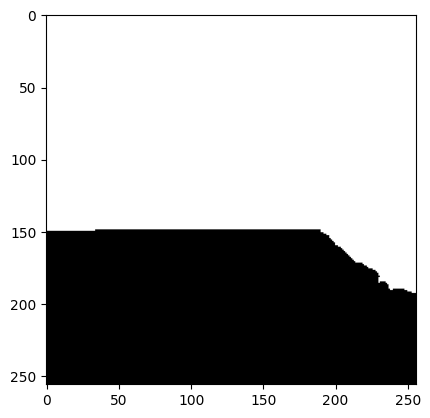

(850, 478)


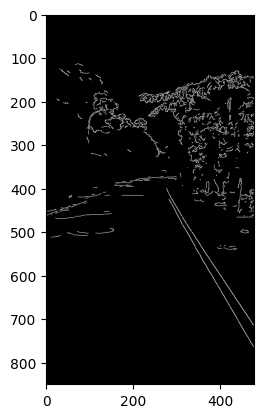

[[[320 495 473 759]]

 [[365 548 477 714]]

 [[342 512 466 697]]

 [[382 601 476 763]]]


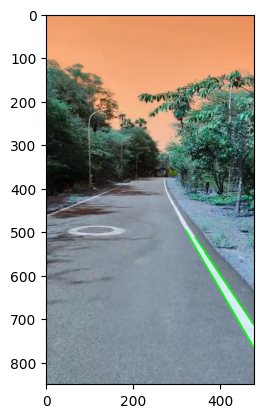

25714


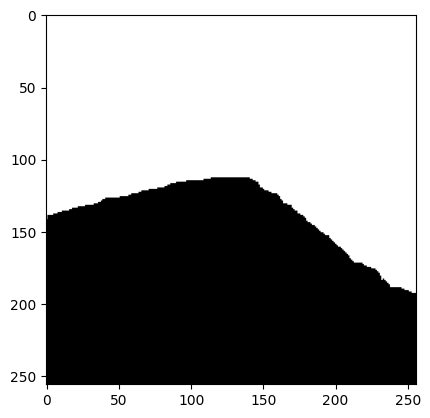

15427


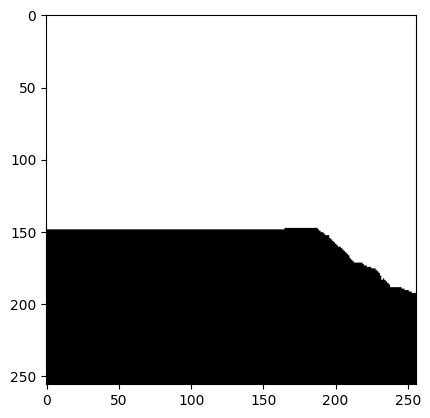

(850, 478)


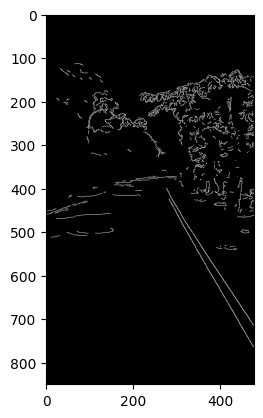

[[[319 492 476 764]]

 [[330 492 431 647]]

 [[412 616 476 714]]

 [[319 493 473 760]]]


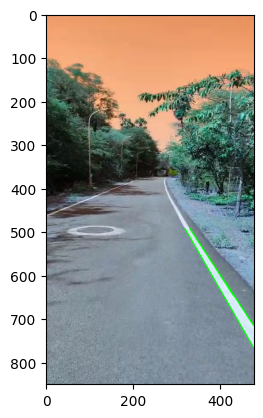

25689


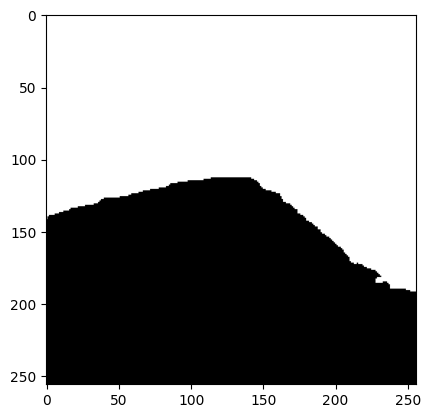

15412


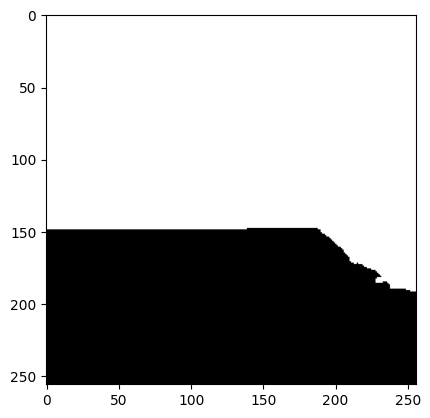

(850, 478)


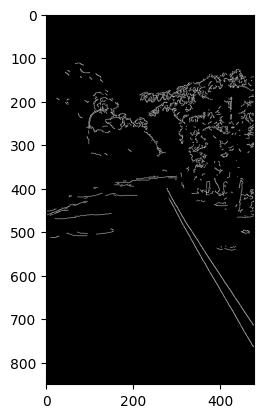

[[[320 494 475 763]]

 [[330 492 436 655]]

 [[331 492 475 713]]

 [[389 613 476 763]]]


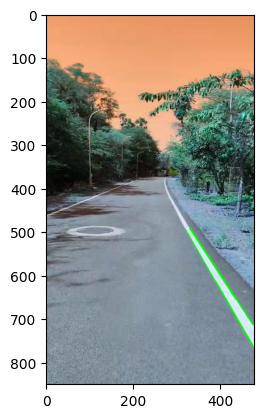

25578


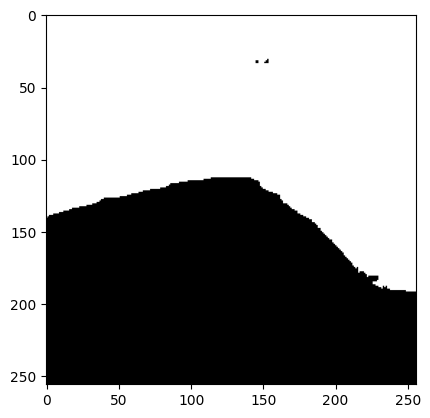

15346


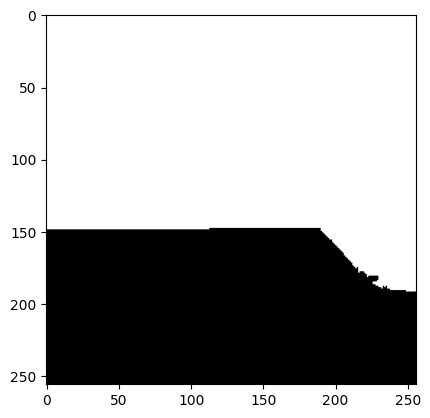

(850, 478)


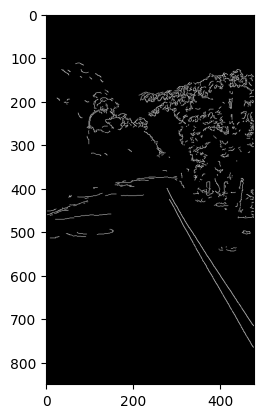

[[[330 492 476 716]]

 [[319 492 477 765]]

 [[333 518 475 764]]

 [[330 493 440 662]]]


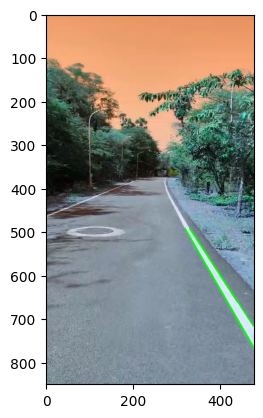

25575


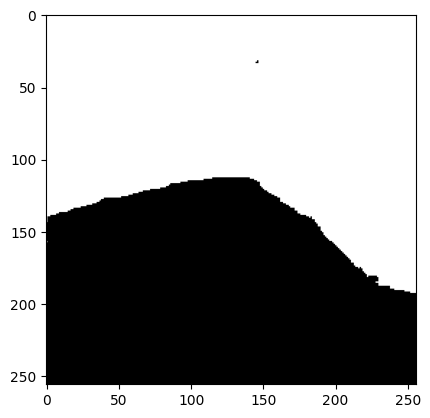

15344


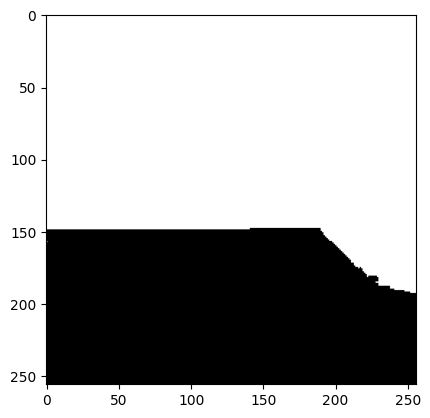

(850, 478)


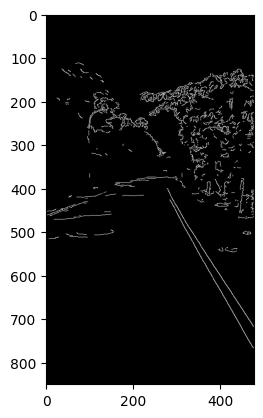

[[[330 492 476 717]]

 [[340 530 476 766]]

 [[330 493 475 716]]

 [[319 493 447 715]]]


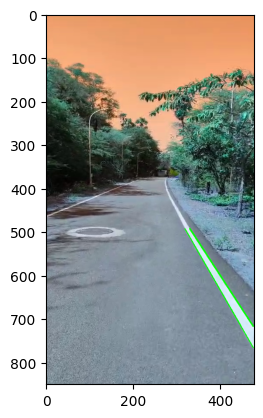

25528


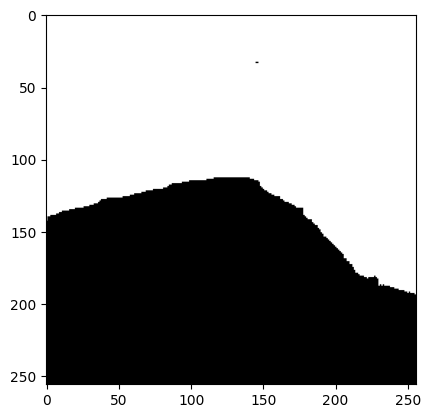

15316


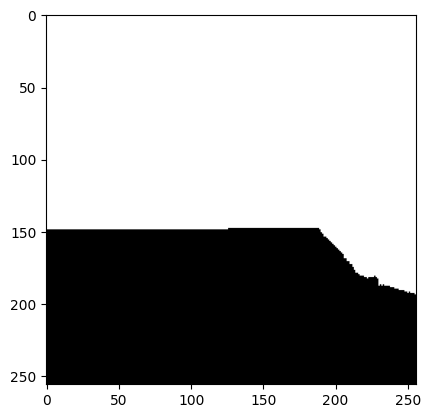

(850, 478)


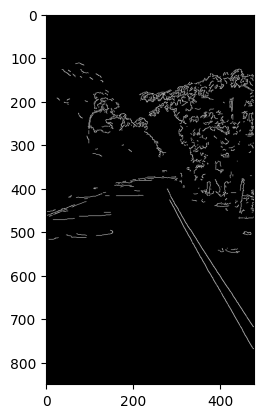

[[[329 492 476 718]]

 [[336 526 476 769]]

 [[318 492 449 720]]

 [[329 493 474 716]]]


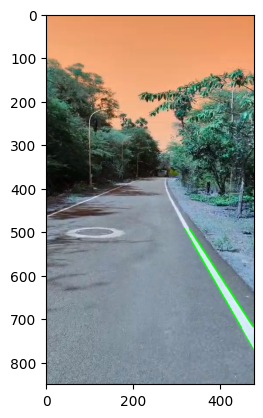

25642


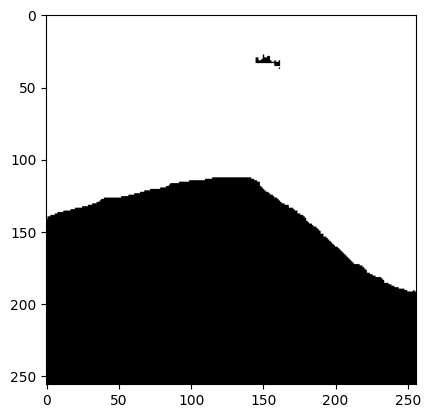

15384


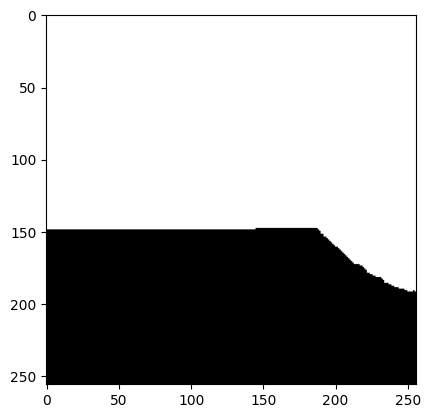

(850, 478)


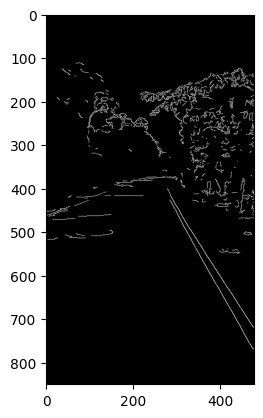

[[[347 544 457 736]]

 [[329 492 477 719]]

 [[362 544 475 718]]

 [[368 582 476 769]]

 [[330 513 432 691]]]


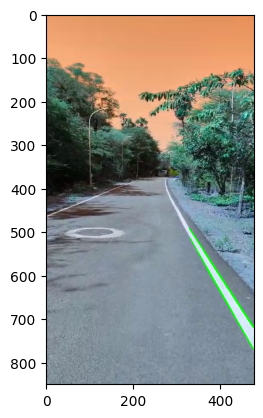

25677


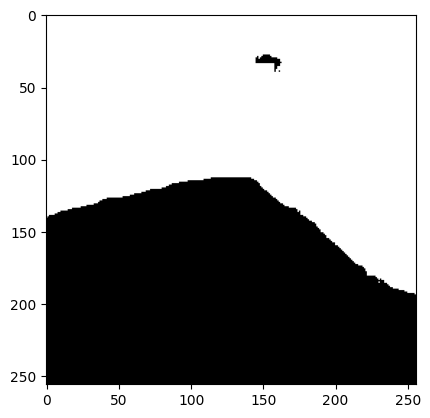

15405


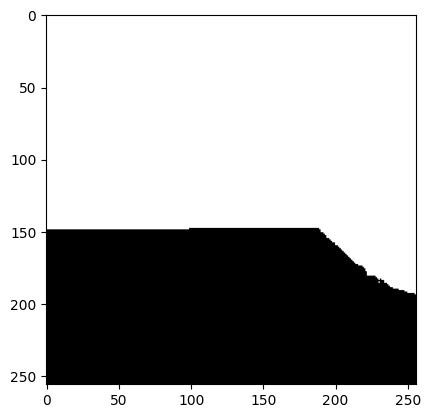

(850, 478)


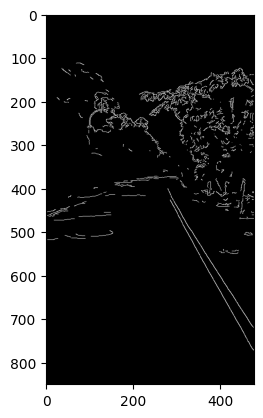

[[[379 599 474 769]]

 [[329 492 477 719]]

 [[359 539 476 719]]

 [[319 493 396 631]]]


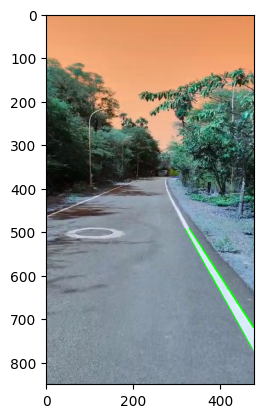

25392


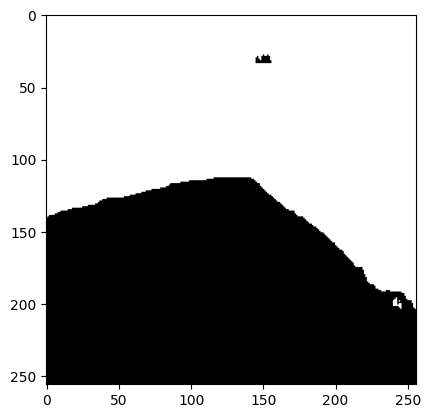

15234


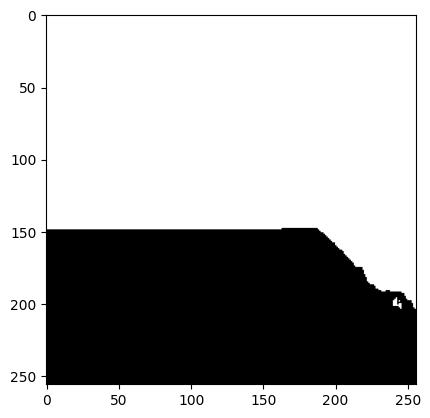

(850, 478)


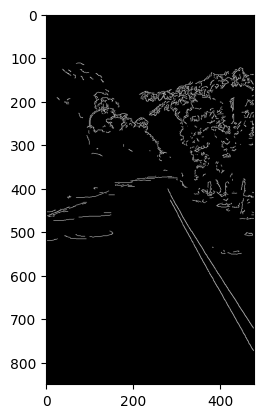

[[[363 546 476 721]]

 [[320 493 474 770]]

 [[319 492 417 669]]

 [[329 492 441 665]]

 [[427 684 476 772]]]


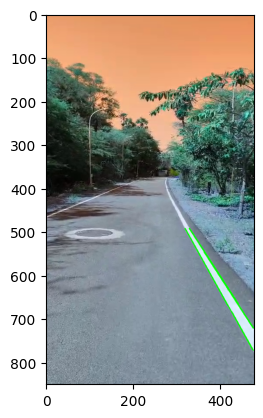

25432


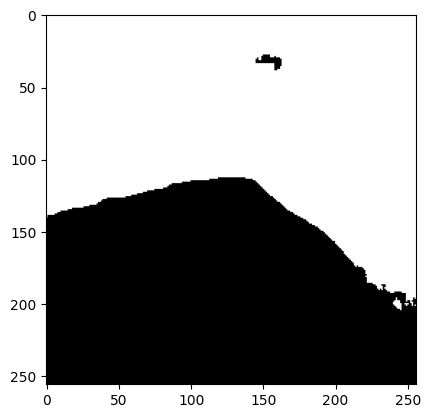

15258


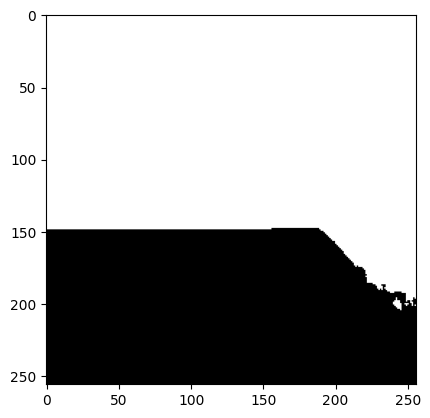

(850, 478)


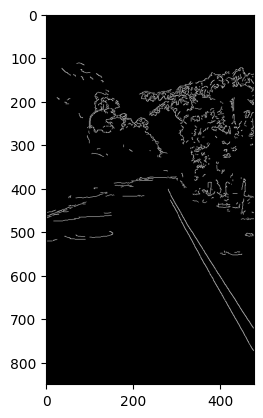

[[[319 492 472 767]]

 [[375 565 476 721]]

 [[349 523 477 721]]

 [[383 606 476 773]]]


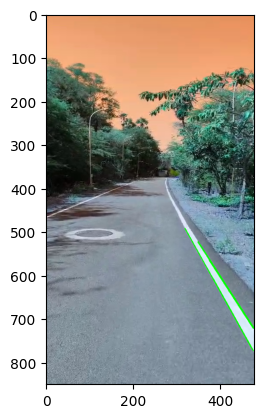

25551


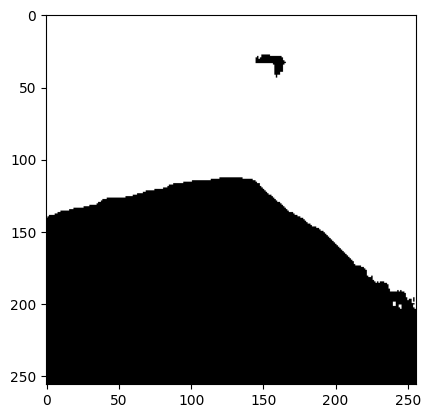

15330


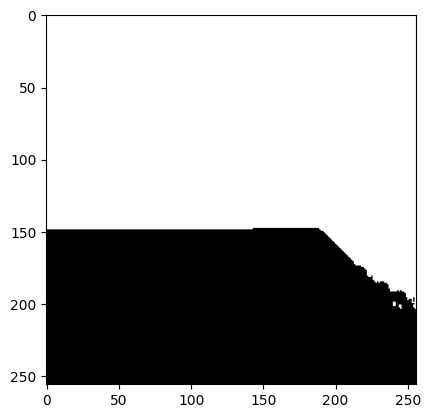

(850, 478)


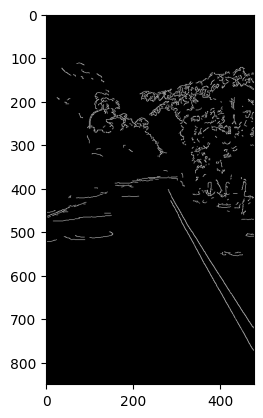

[[[320 493 473 768]]

 [[359 539 477 721]]

 [[319 492 425 683]]

 [[351 526 439 662]]

 [[404 643 474 769]]]


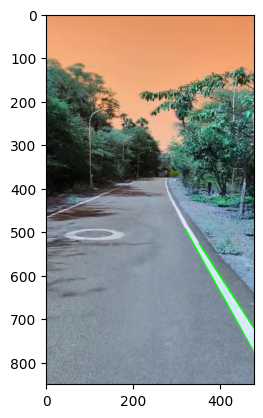

25559


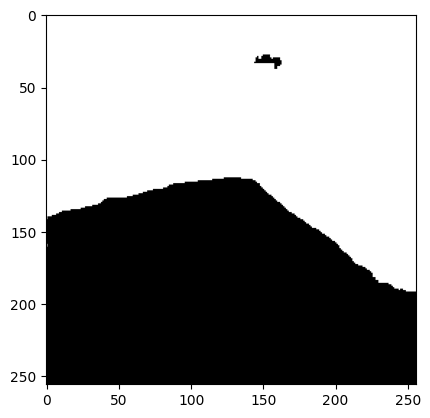

15334


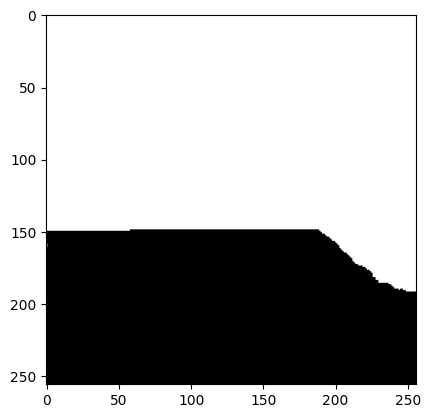

(850, 478)


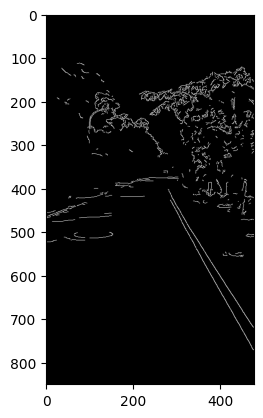

[[[334 499 477 719]]

 [[322 496 449 724]]

 [[368 553 476 719]]

 [[365 576 477 771]]

 [[332 495 394 591]]]


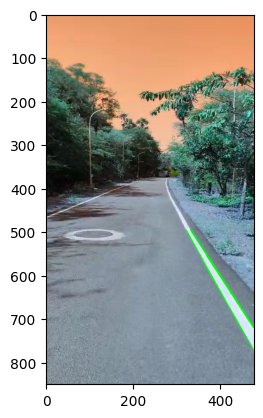

25709


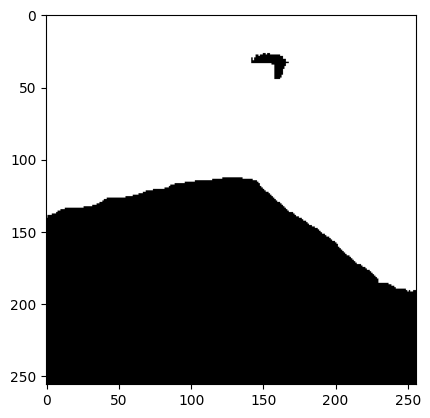

15424


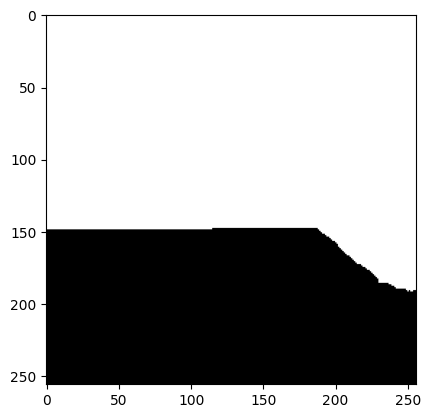

(850, 478)


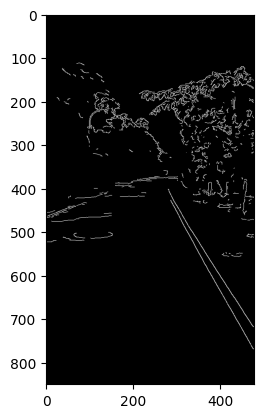

[[[345 539 477 769]]

 [[353 528 476 718]]

 [[363 572 476 769]]

 [[330 492 452 680]]]


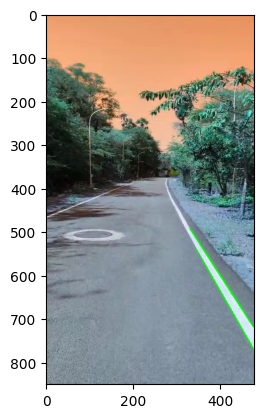

25858


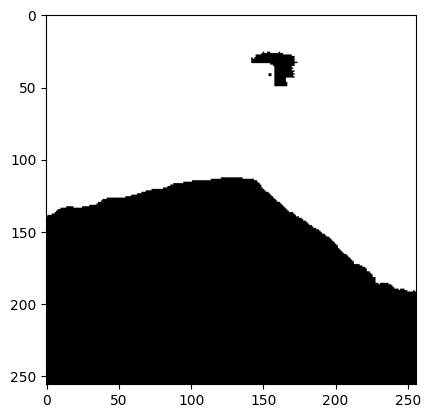

15514


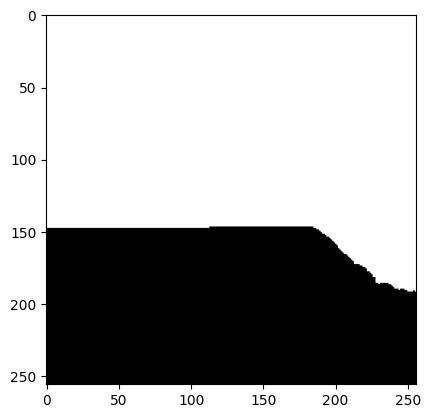

(850, 478)


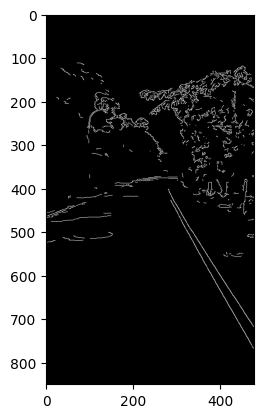

[[[360 565 476 767]]

 [[330 492 476 717]]

 [[344 536 477 767]]

 [[329 489 477 717]]

 [[319 491 387 610]]]


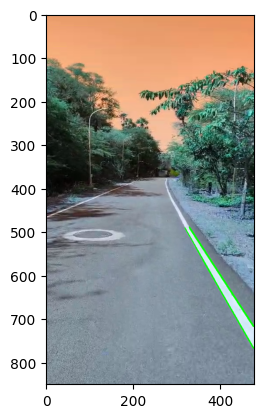

25910


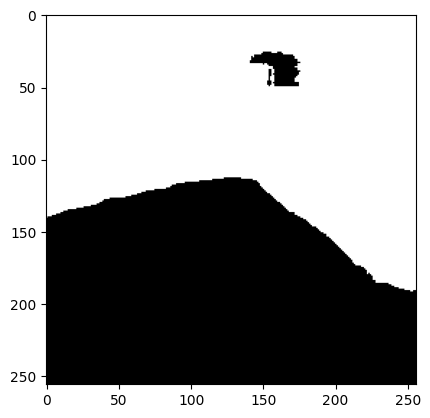

15545


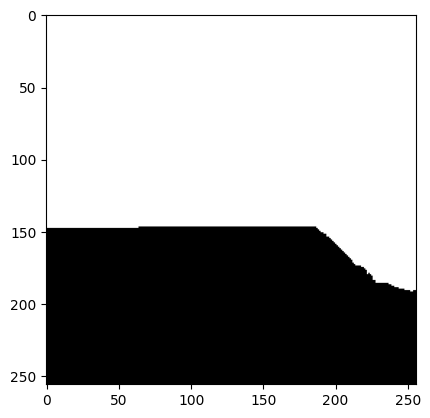

(850, 478)


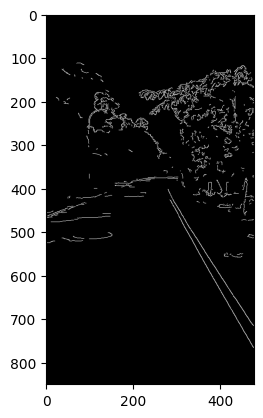

[[[328 489 473 712]]

 [[318 490 476 765]]

 [[352 551 476 766]]

 [[329 489 474 713]]]


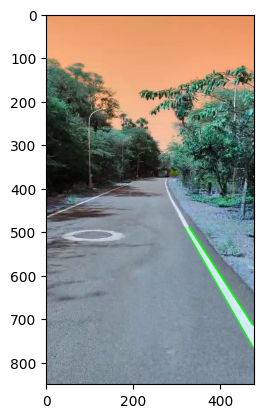

25925


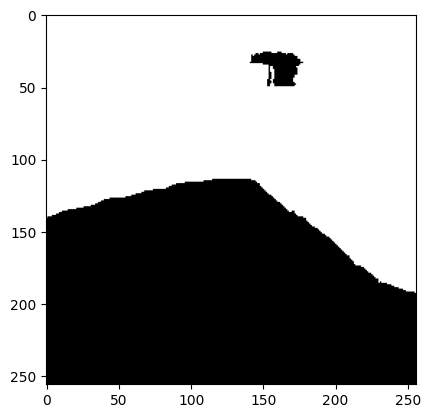

15554


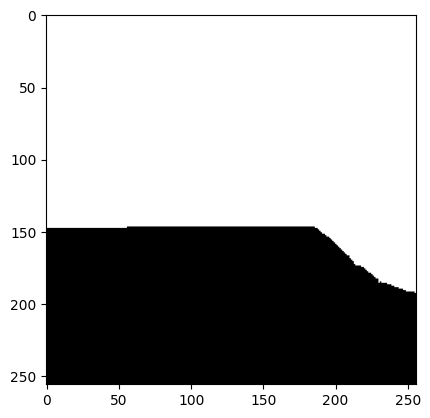

(850, 478)


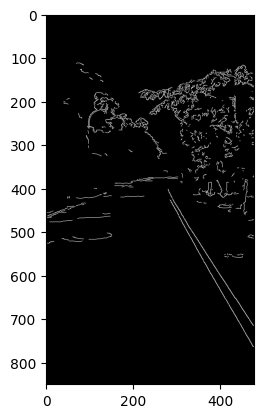

[[[321 495 476 764]]

 [[328 489 468 704]]

 [[411 615 476 715]]

 [[398 628 476 763]]]


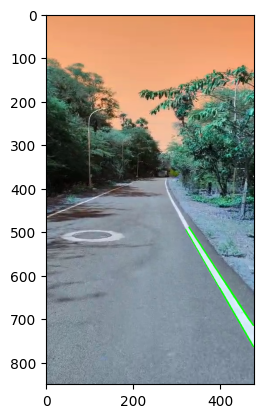

26020


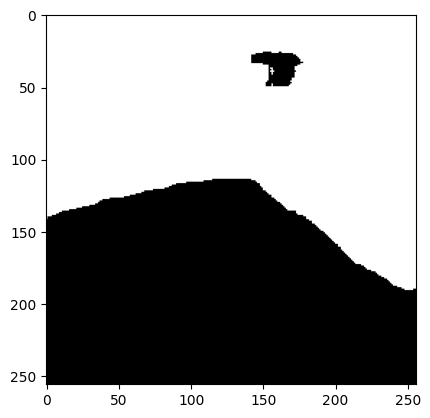

15611


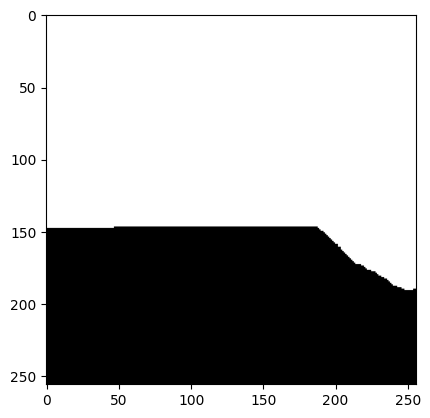

(850, 478)


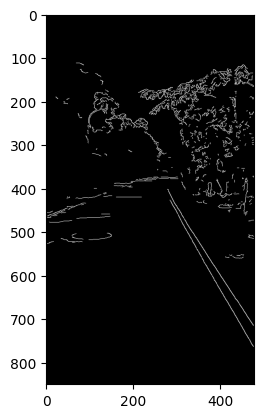

[[[318 490 476 763]]

 [[328 489 475 714]]

 [[329 489 476 715]]]


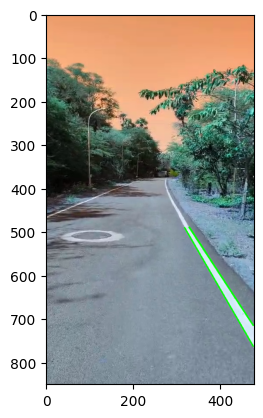

25850


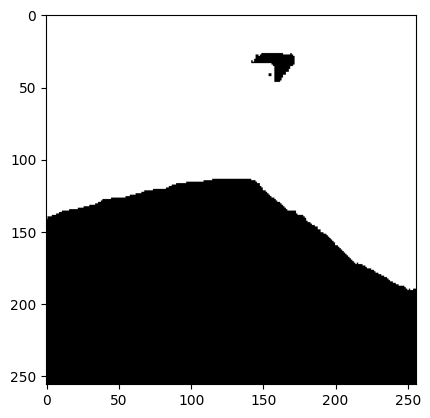

15509


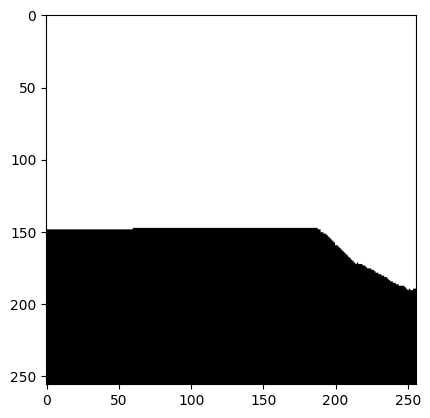

(850, 478)


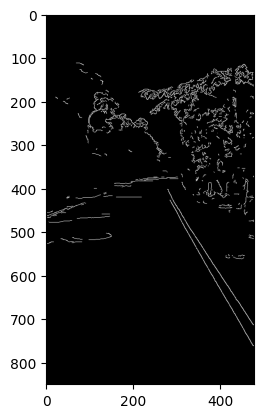

[[[320 492 476 762]]

 [[335 498 476 714]]

 [[319 492 431 686]]

 [[331 492 438 657]]

 [[418 624 476 713]]]


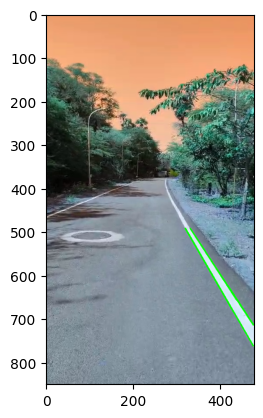

25796


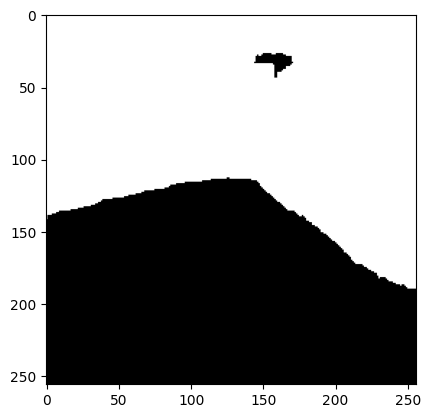

15477


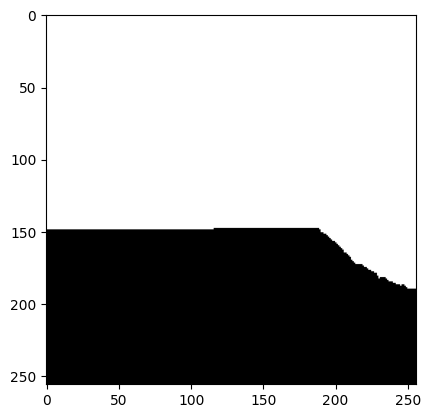

(850, 478)


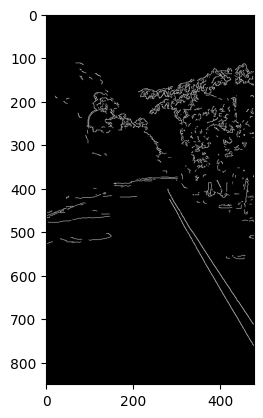

[[[320 492 474 758]]

 [[331 492 440 659]]

 [[419 625 476 712]]

 [[345 537 416 660]]

 [[419 662 476 761]]]


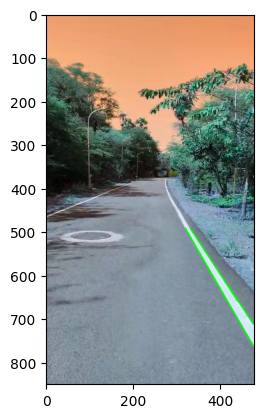

25767


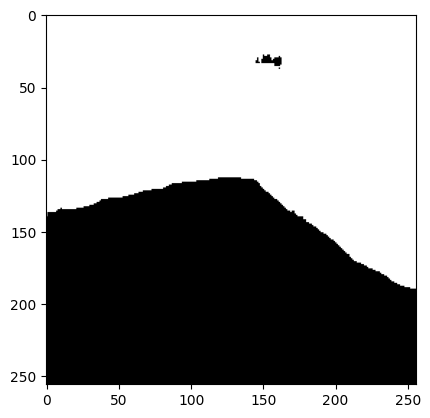

15459


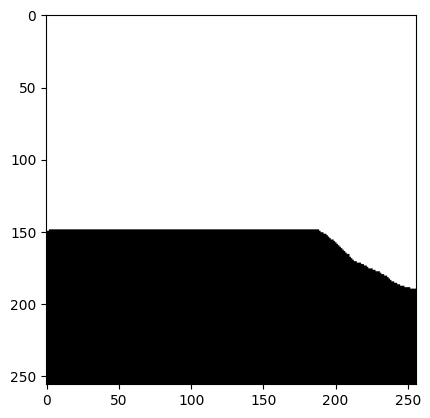

(850, 478)


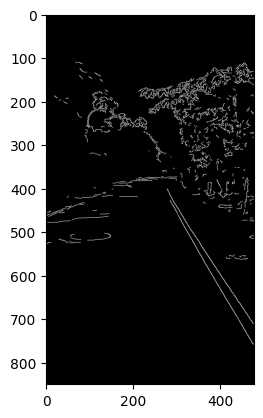

[[[322 495 434 689]]

 [[358 535 476 710]]

 [[415 655 474 756]]

 [[322 497 404 639]]

 [[333 495 426 638]]]


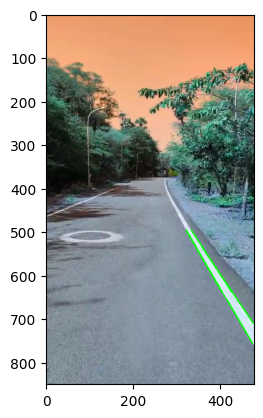

25877


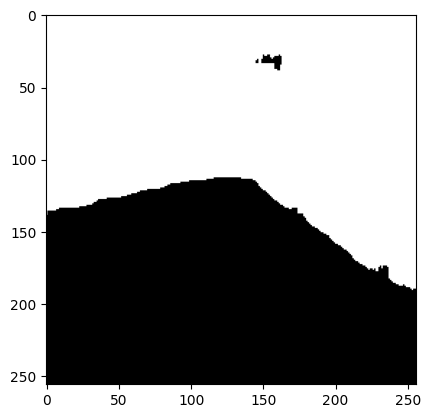

15525


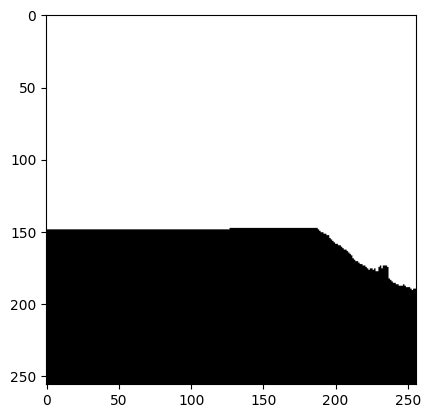

(850, 478)


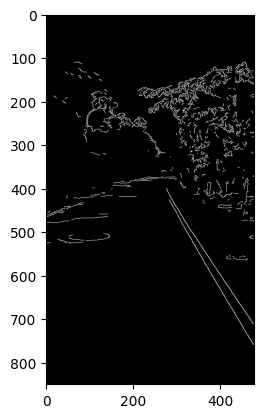

[[[352 551 477 759]]

 [[358 536 476 711]]

 [[329 492 477 711]]

 [[318 492 400 630]]]


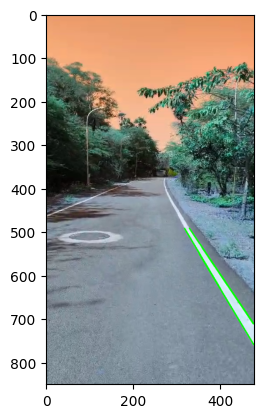

25587


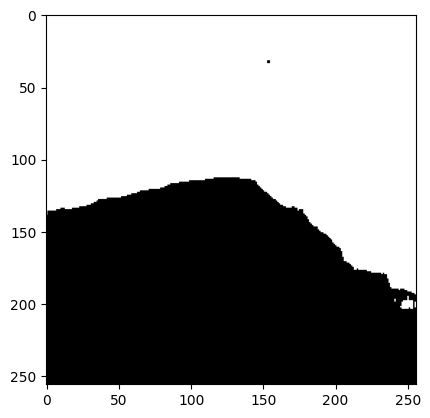

15351


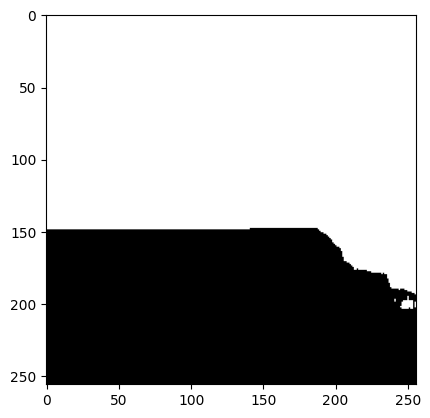

(850, 478)


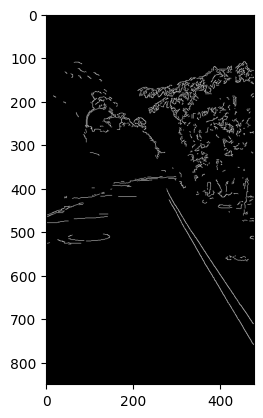

[[[345 539 477 759]]

 [[358 536 476 711]]

 [[329 492 401 599]]

 [[329 511 452 717]]]


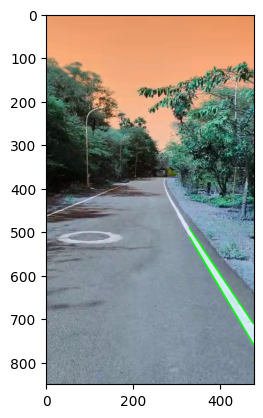

25671


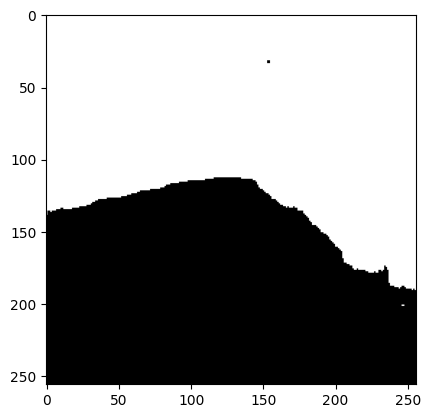

15402


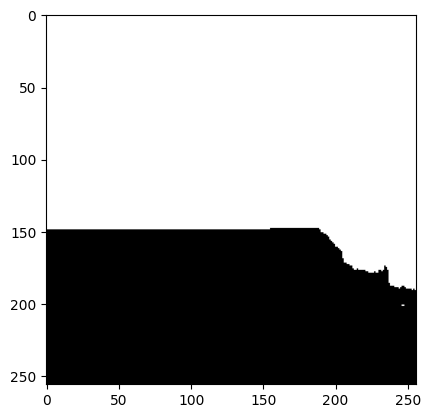

(850, 478)


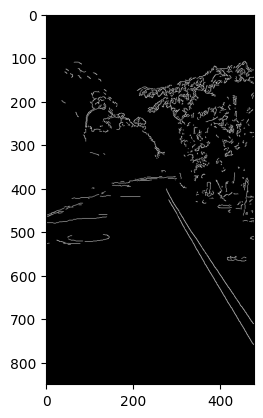

[[[328 492 475 710]]

 [[344 538 476 759]]

 [[321 496 419 665]]

 [[329 492 405 605]]]


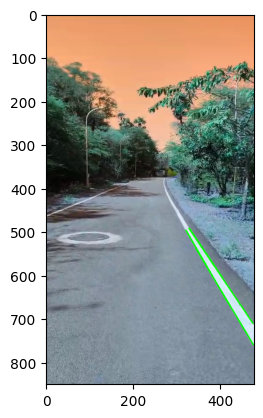

25677


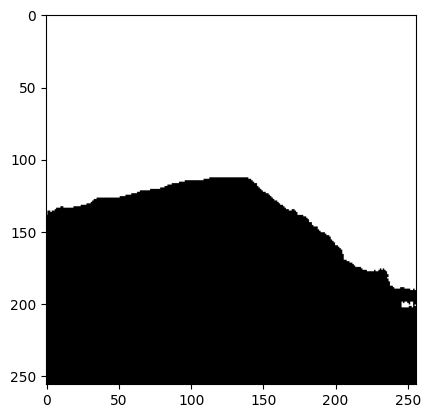

15405


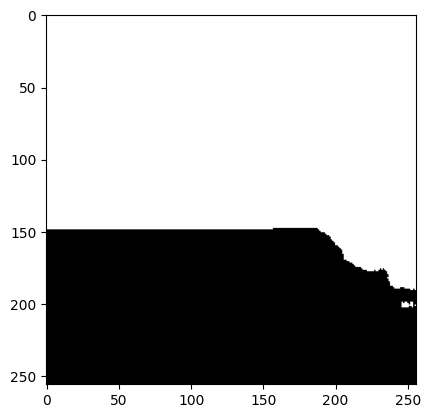

(850, 478)


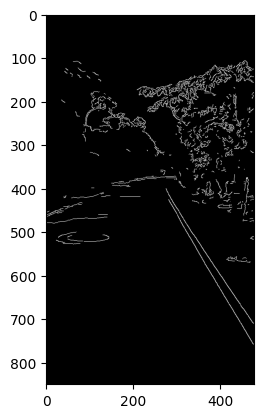

[[[357 535 473 707]]

 [[346 541 476 758]]

 [[329 492 476 710]]

 [[319 494 477 758]]

 [[329 493 475 709]]]


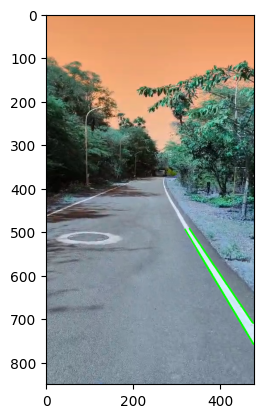

25311


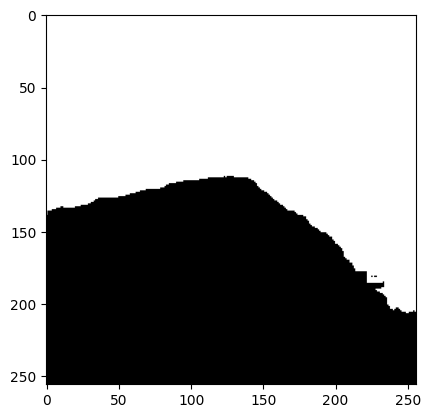

15186


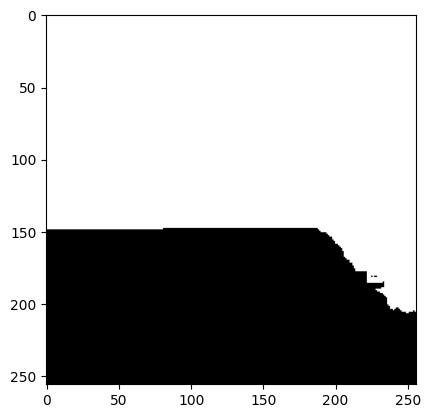

(850, 478)


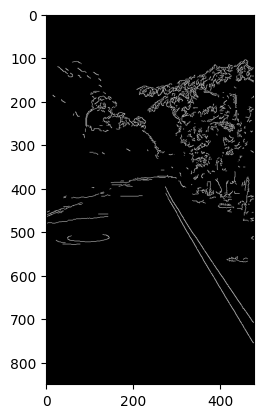

[[[329 492 474 706]]

 [[346 539 475 754]]

 [[330 492 440 655]]

 [[319 493 476 755]]]


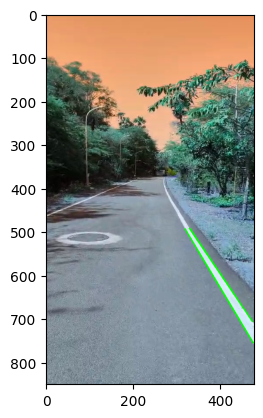

25400


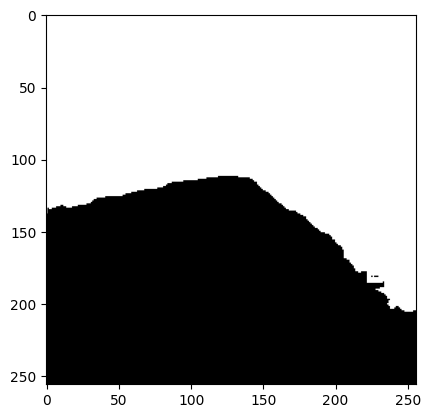

15239


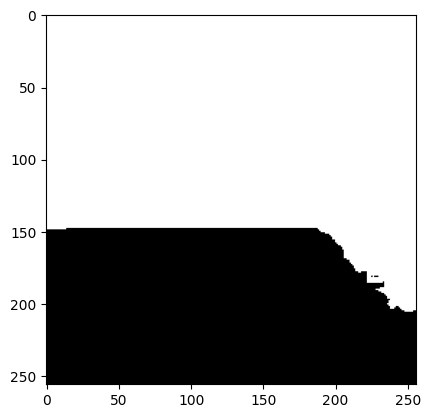

(850, 478)


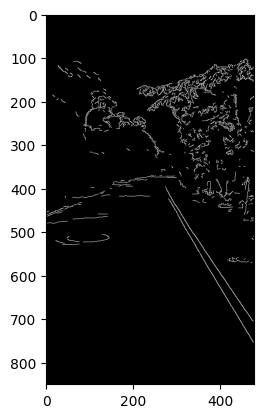

[[[319 492 476 753]]

 [[331 492 474 704]]

 [[345 536 475 753]]

 [[330 492 456 679]]]


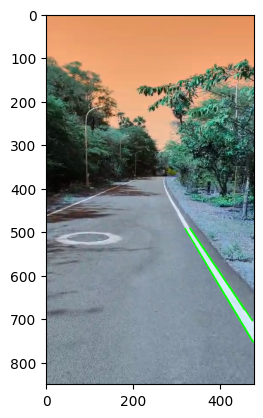

25639


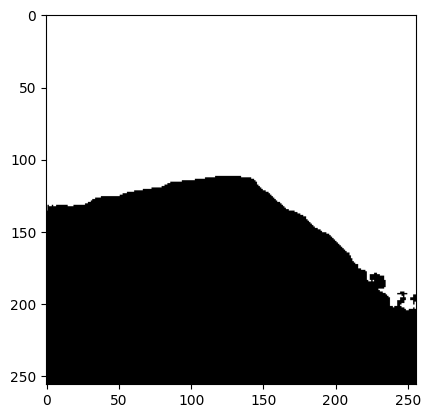

15382


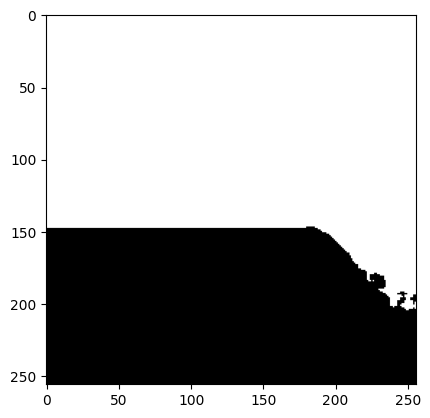

(850, 478)


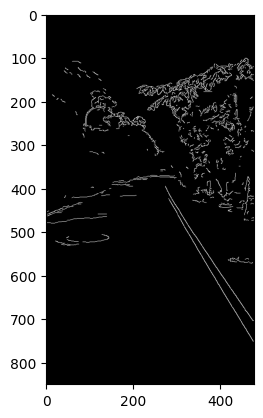

[[[331 492 460 683]]

 [[320 493 475 751]]

 [[332 493 475 704]]]


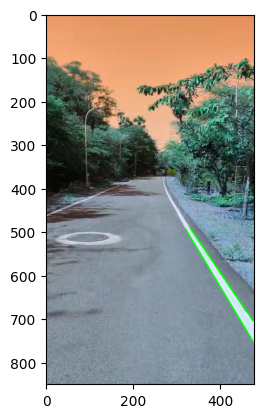

25998


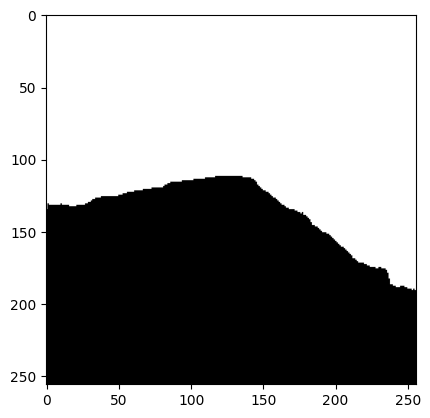

15598


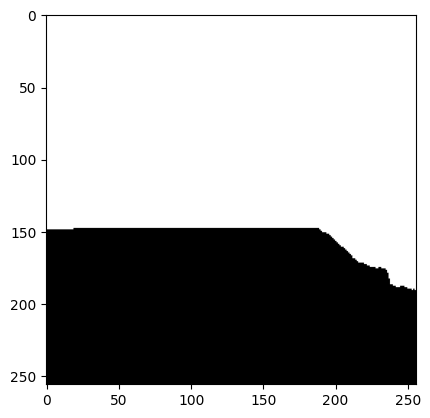

(850, 478)


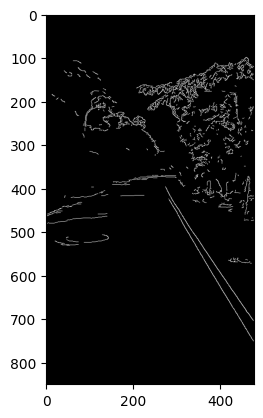

[[[387 603 476 750]]

 [[331 492 462 685]]

 [[336 517 409 642]]

 [[324 497 385 602]]

 [[341 505 475 703]]]


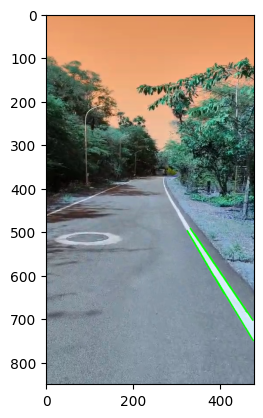

26035


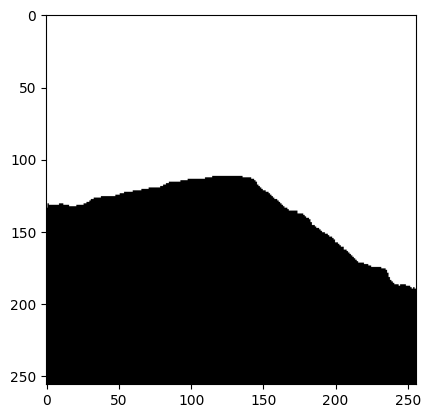

15620


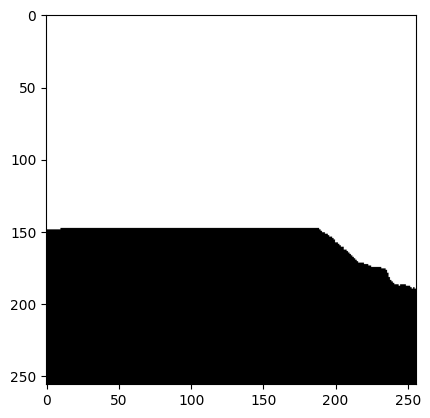

(850, 478)


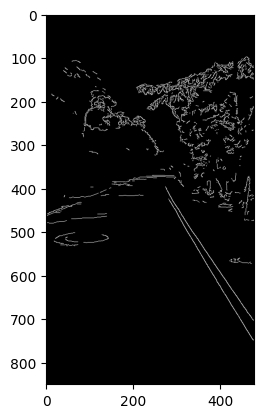

[[[320 492 439 690]]

 [[332 492 467 691]]

 [[386 601 475 748]]

 [[331 492 425 631]]]


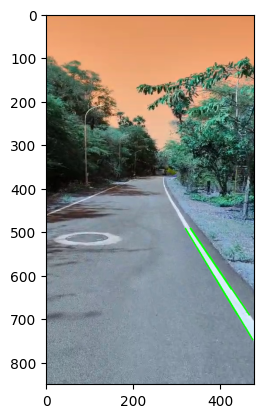

26046


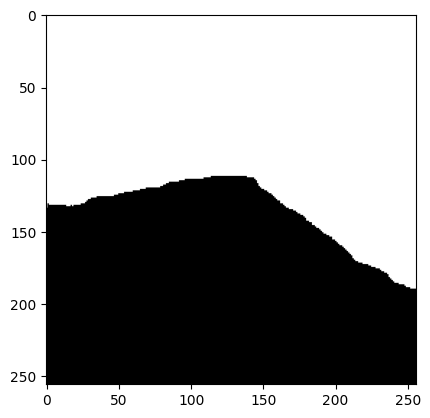

15627


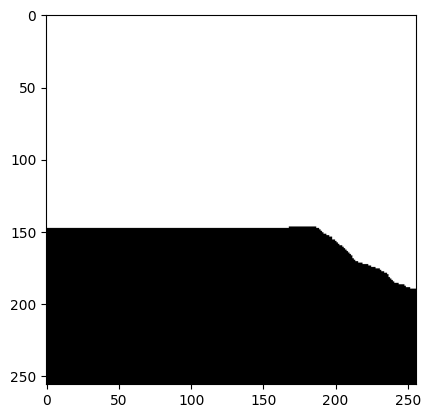

(850, 478)


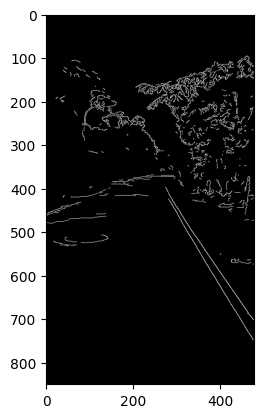

[[[318 489 463 729]]

 [[330 490 436 646]]

 [[388 604 475 748]]

 [[390 577 469 693]]

 [[318 490 424 666]]

 [[329 489 387 575]]]


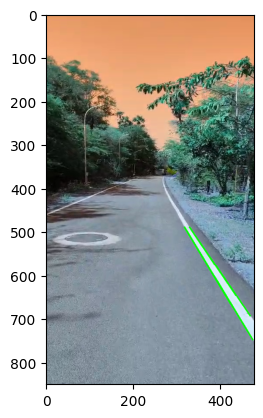

25938


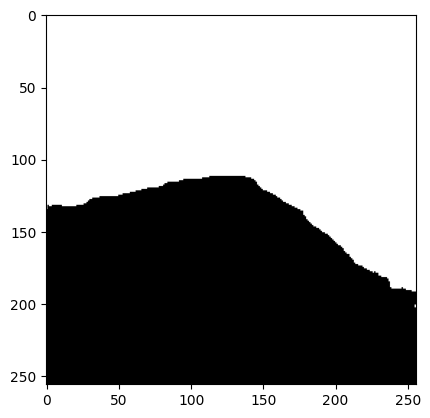

15562


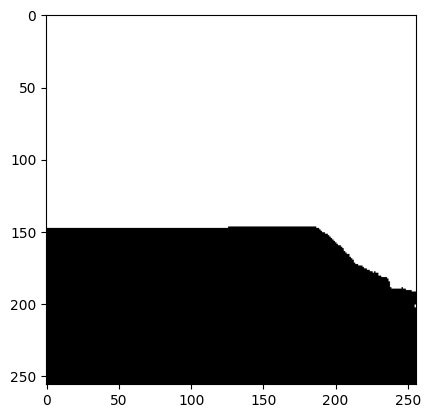

(850, 478)


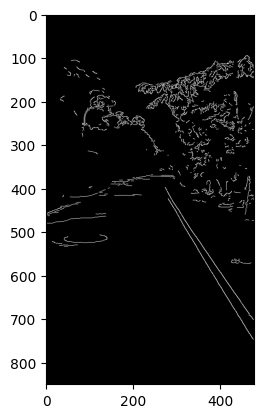

[[[319 490 442 694]]

 [[364 541 476 701]]

 [[329 489 406 600]]

 [[367 572 475 746]]]


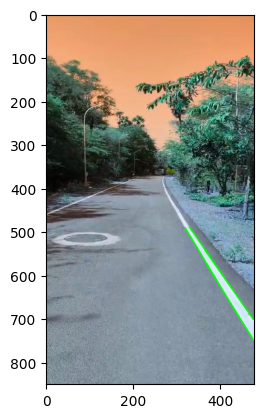

26054


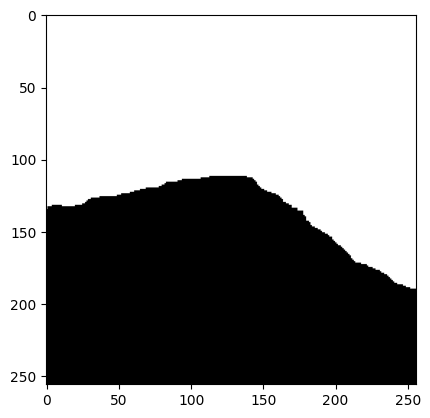

15631


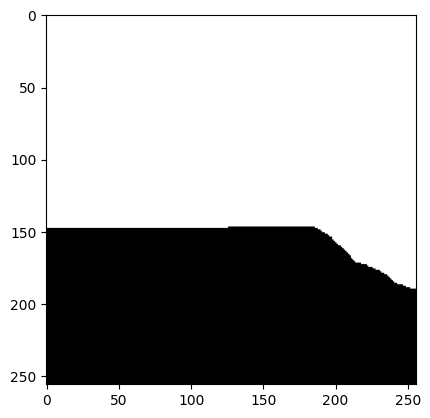

(850, 478)


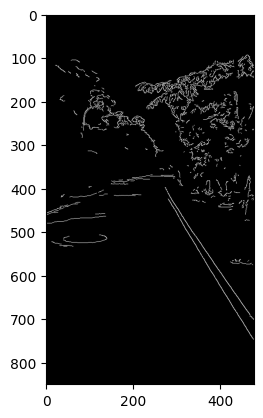

[[[358 532 476 701]]

 [[319 490 443 695]]

 [[329 489 406 600]]

 [[356 553 476 746]]]


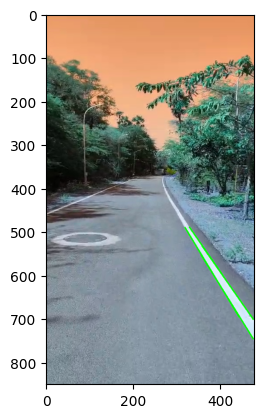

26048


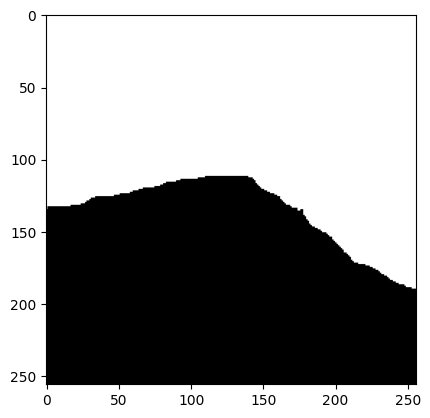

15628


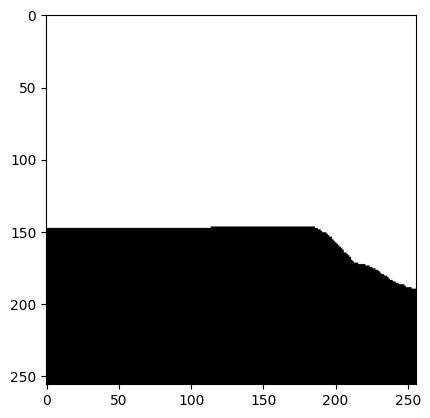

(850, 478)


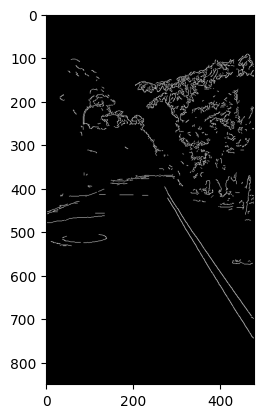

[[[319 492 476 744]]

 [[329 489 476 699]]

 [[334 498 473 697]]

 [[359 558 473 741]]]


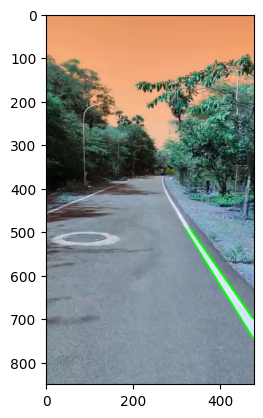

26097


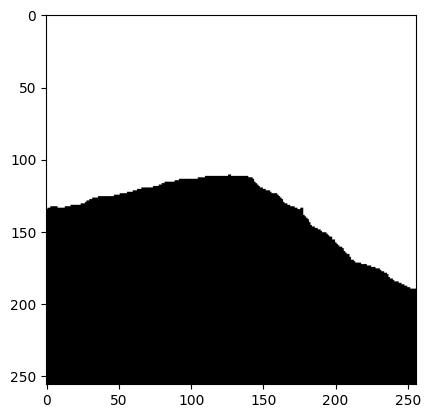

15657


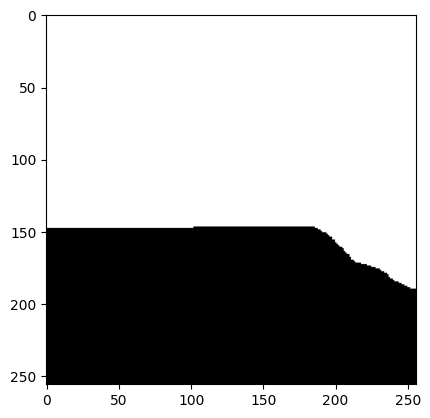

(850, 478)


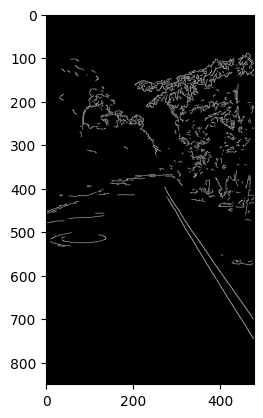

[[[319 492 477 745]]

 [[329 489 477 700]]

 [[329 490 475 699]]

 [[318 489 399 623]]]


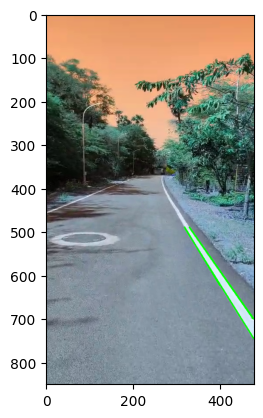

No right lines found. Using left lines for both lanes.
26085


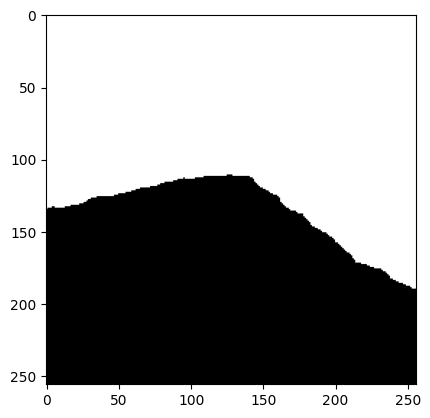

15650


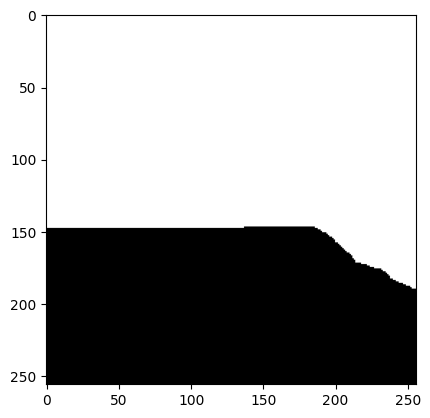

(850, 478)


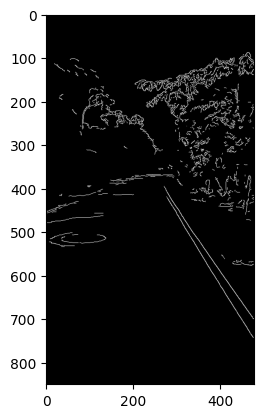

[[[329 489 476 699]]

 [[345 534 474 741]]

 [[318 490 475 742]]

 [[361 536 476 700]]]


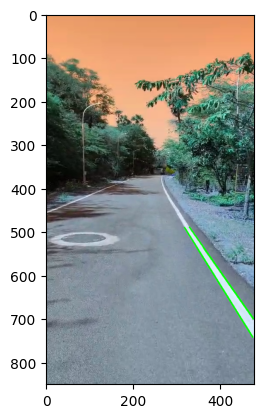

26038


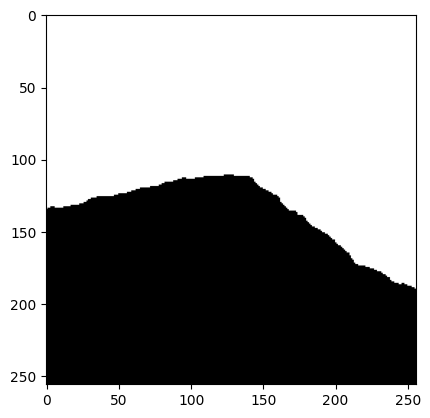

15622


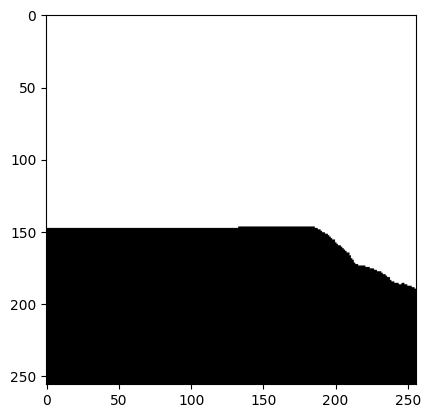

(850, 478)


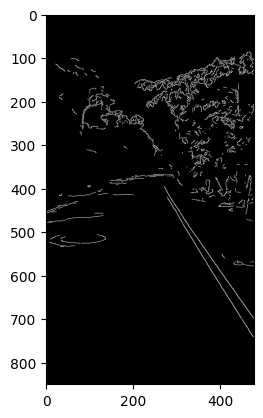

[[[318 489 475 740]]

 [[329 489 474 695]]

 [[330 489 476 697]]]


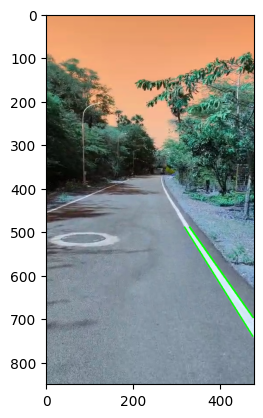

26016


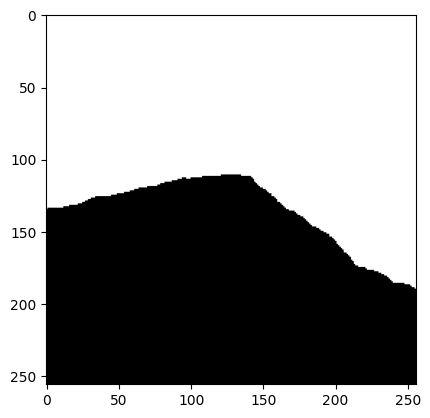

15609


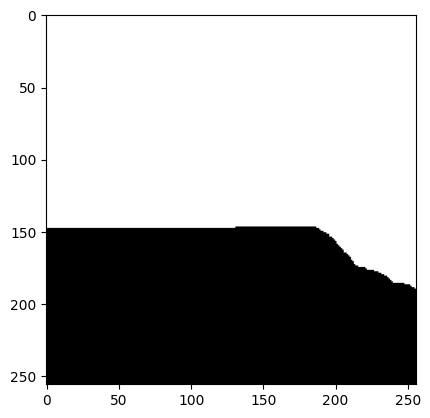

(850, 478)


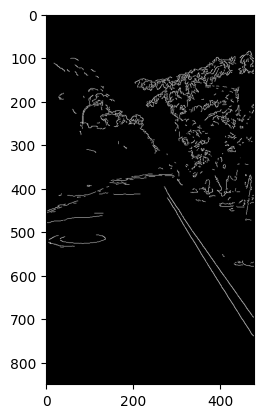

[[[319 490 473 736]]

 [[330 489 475 695]]

 [[326 502 450 701]]

 [[347 512 476 696]]]


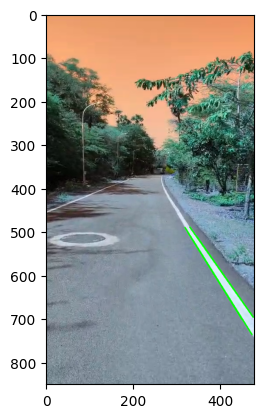

26083


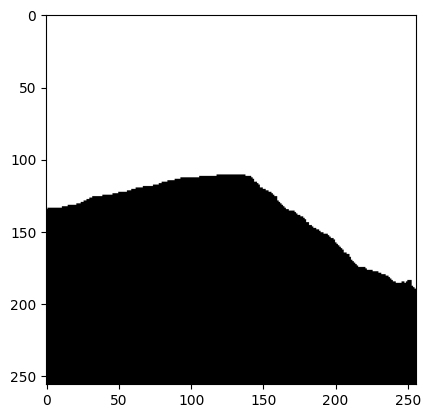

15649


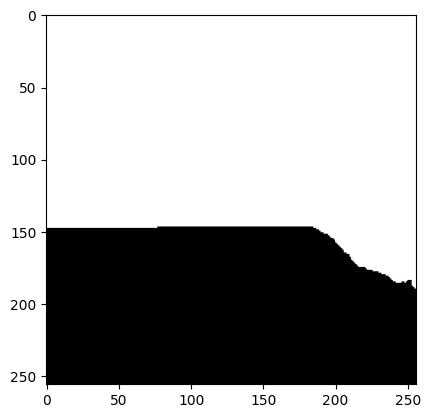

(850, 478)


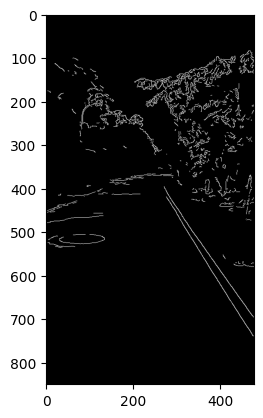

[[[331 490 476 696]]

 [[318 489 474 738]]

 [[329 489 441 648]]

 [[351 543 422 657]]]


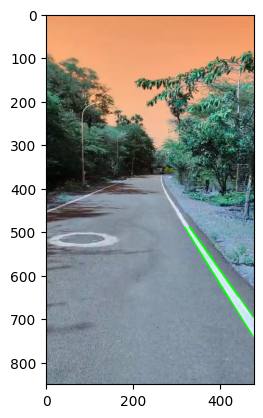

26304


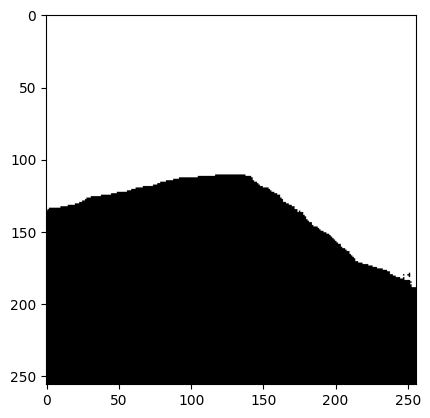

15781


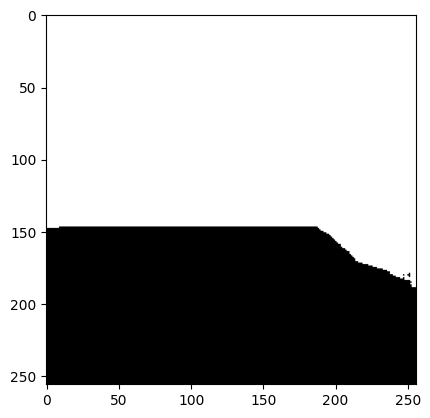

(850, 478)


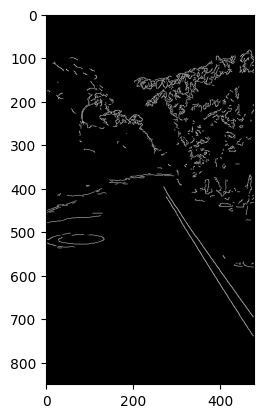

[[[317 489 452 704]]

 [[330 490 466 683]]

 [[318 489 473 736]]

 [[377 558 476 695]]]


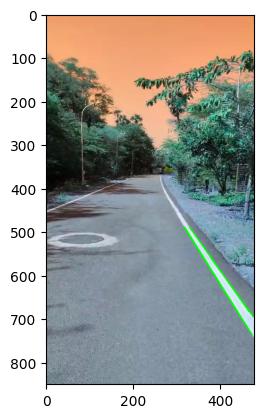

26220


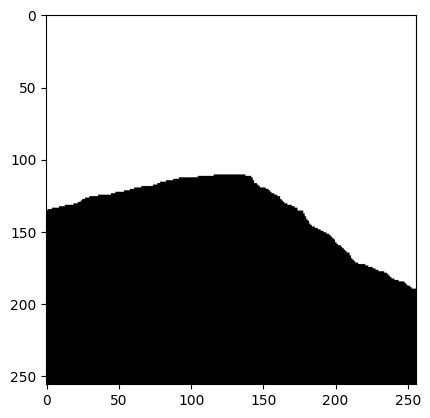

15731


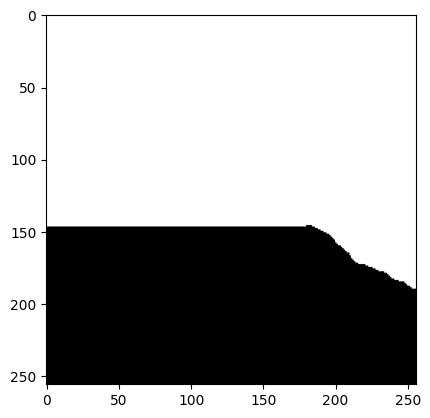

(850, 478)


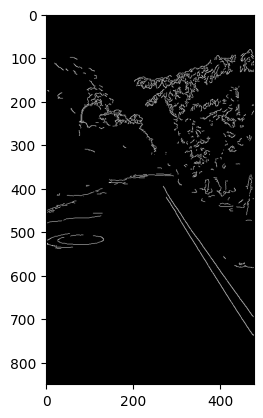

[[[317 489 450 701]]

 [[349 516 473 692]]

 [[329 489 425 626]]

 [[318 489 462 719]]]


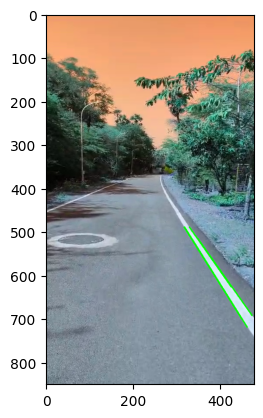

26360


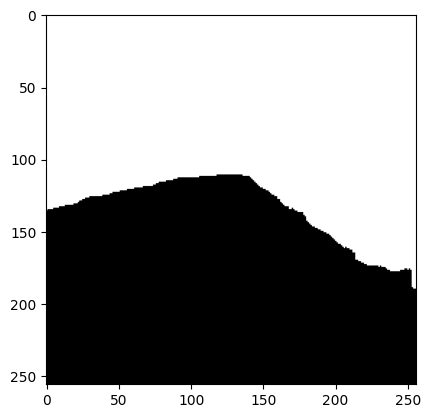

15815


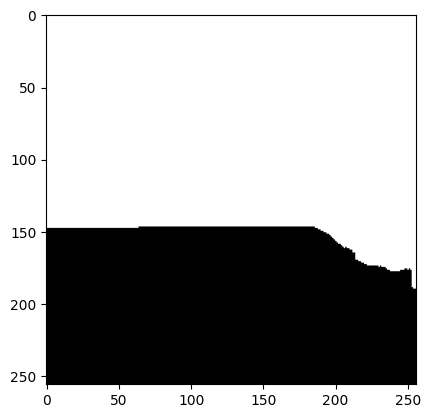

(850, 478)


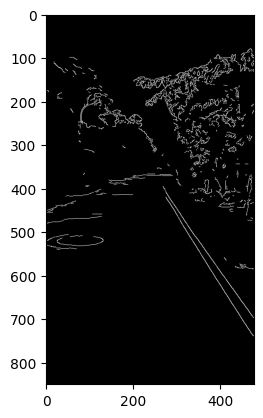

[[[317 489 455 709]]

 [[334 499 477 697]]

 [[403 625 473 736]]

 [[317 490 410 639]]

 [[393 582 476 697]]

 [[328 489 389 574]]]


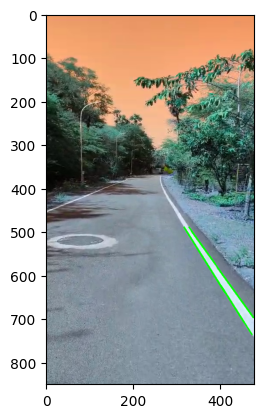

26449


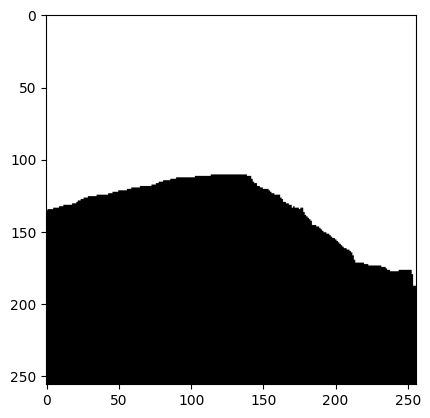

15868


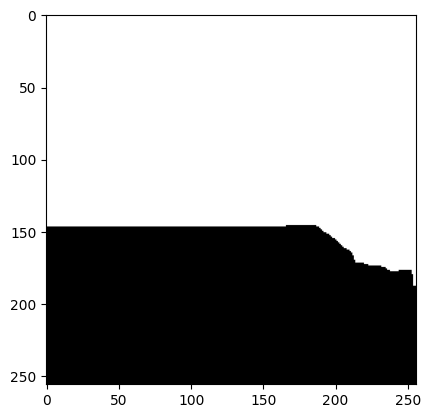

(850, 478)


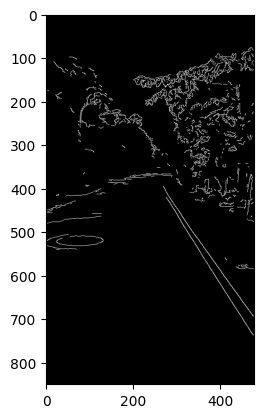

[[[329 490 476 693]]

 [[359 556 476 737]]

 [[384 567 476 694]]

 [[317 489 389 601]]

 [[326 485 407 597]]

 [[399 619 475 736]]]


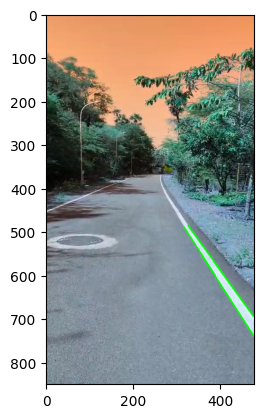

26456


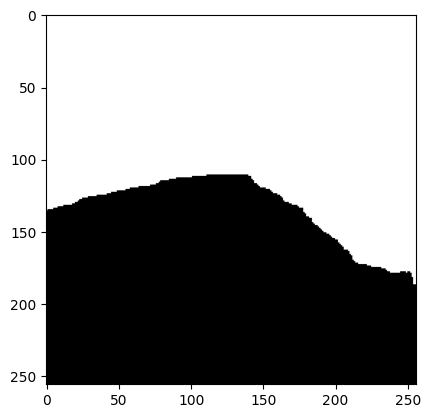

15873


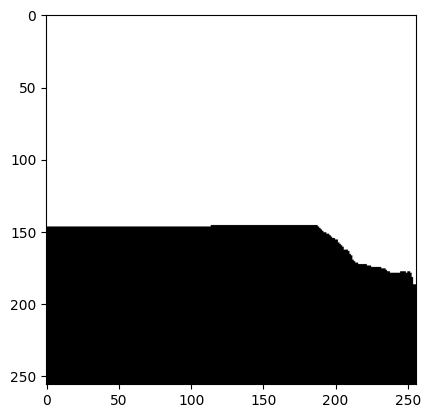

(850, 478)


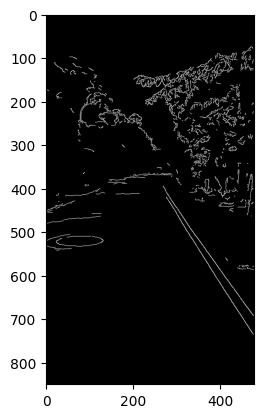

[[[316 485 431 668]]

 [[330 491 476 692]]

 [[326 485 477 692]]

 [[337 517 443 686]]

 [[418 645 473 732]]]


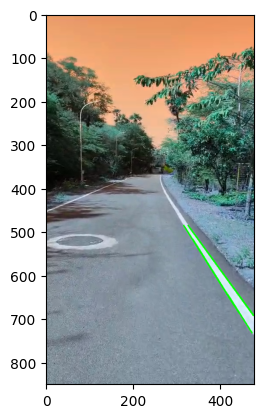

26461


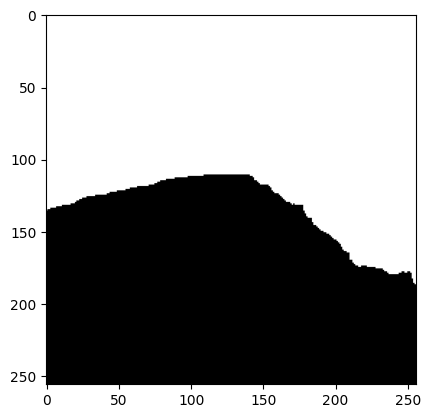

15876


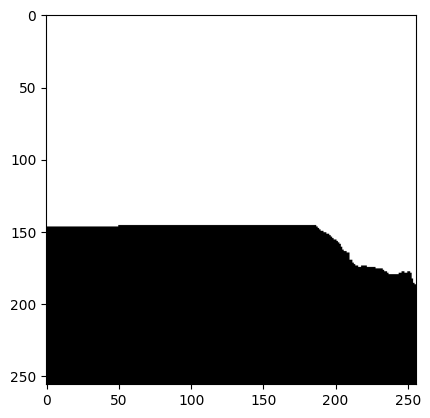

(850, 478)


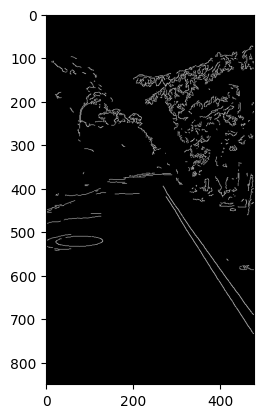

[[[328 487 474 688]]

 [[322 496 476 734]]

 [[328 485 393 575]]

 [[316 485 387 595]]

 [[377 582 475 733]]]


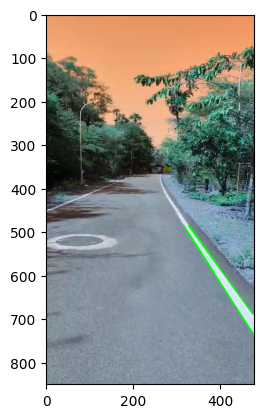

26299


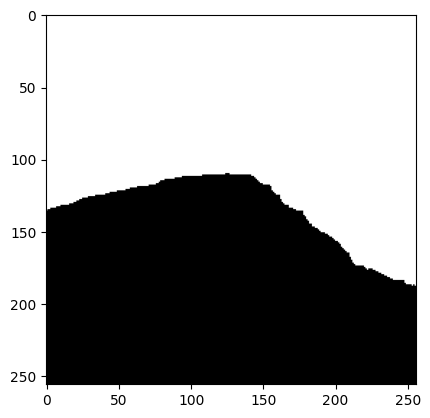

15778


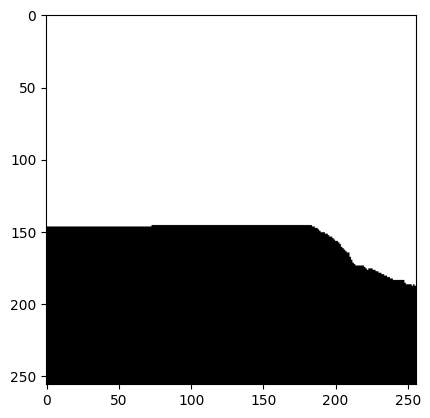

(850, 478)


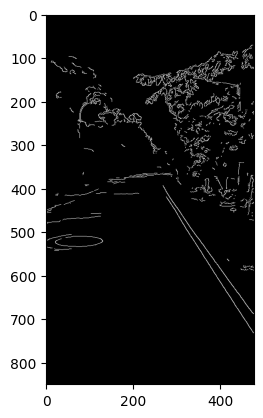

[[[318 488 476 732]]

 [[328 485 474 686]]

 [[329 486 476 688]]]


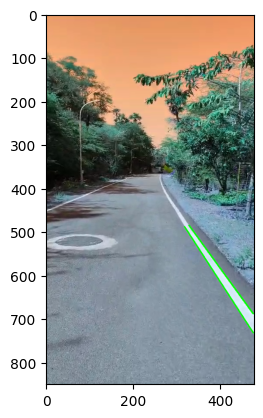

26310


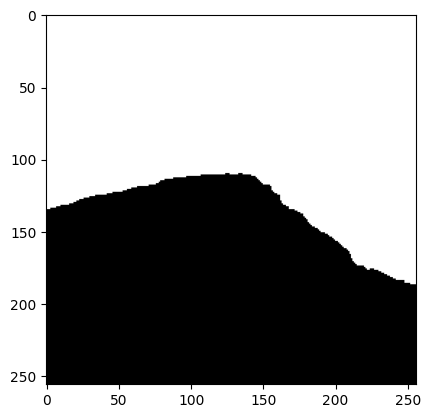

15785


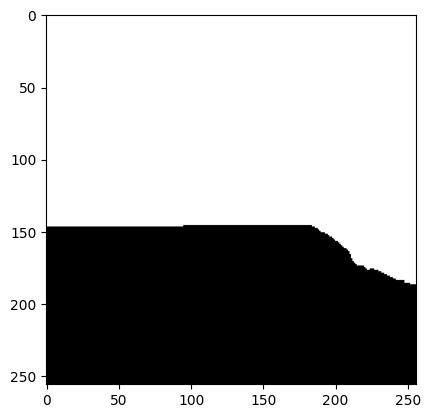

(850, 478)


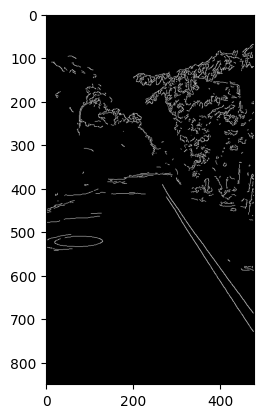

[[[329 485 475 686]]

 [[317 485 474 727]]

 [[328 485 467 676]]]


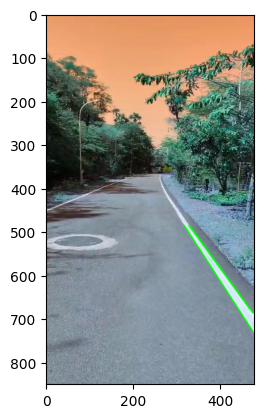

26417


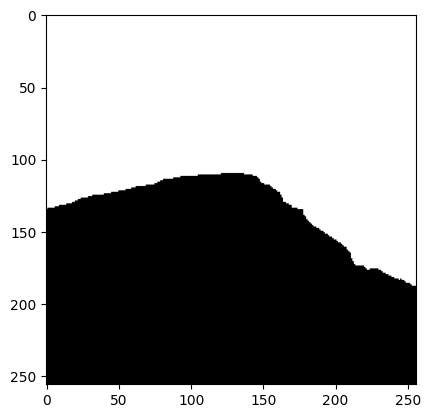

15849


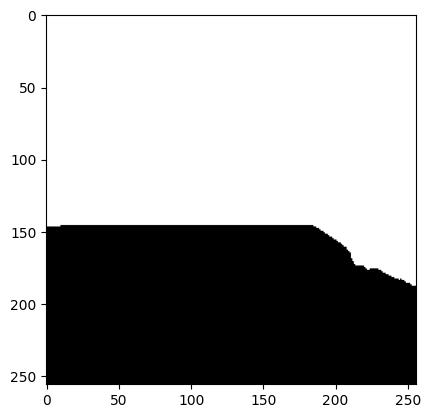

(850, 478)


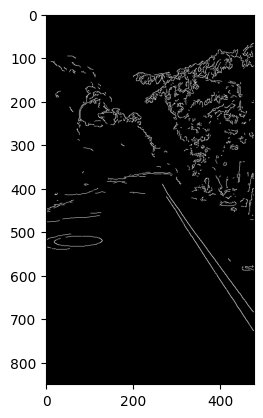

[[[319 486 476 727]]

 [[330 485 469 676]]

 [[351 513 475 683]]

 [[318 485 459 702]]]


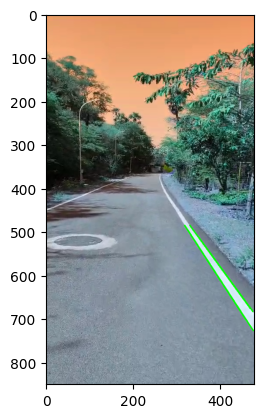

26503


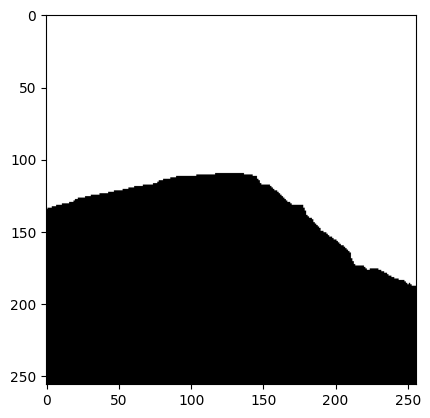

15901


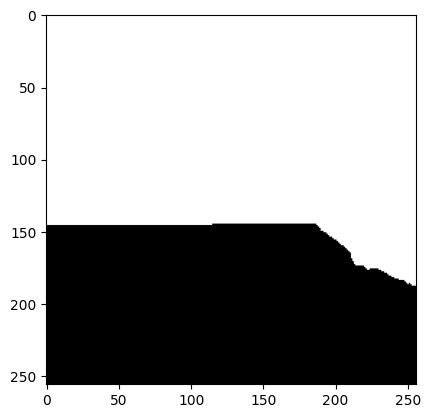

(850, 478)


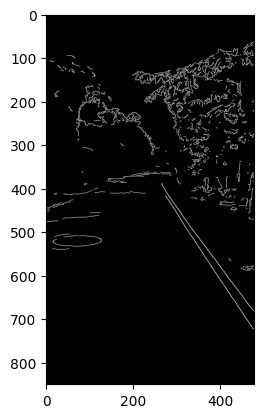

[[[327 482 477 681]]

 [[350 535 477 723]]

 [[332 490 476 681]]

 [[364 557 476 723]]

 [[316 483 405 616]]]


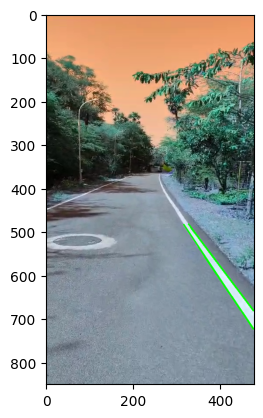

26554


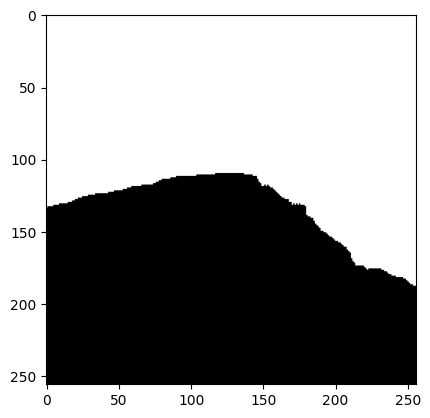

15931


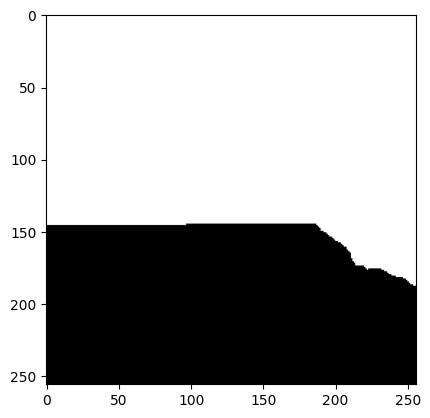

(850, 478)


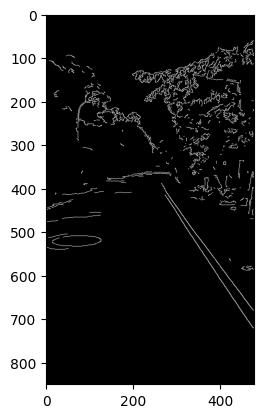

[[[387 590 474 719]]

 [[327 482 477 680]]

 [[316 482 393 597]]

 [[322 492 476 721]]]


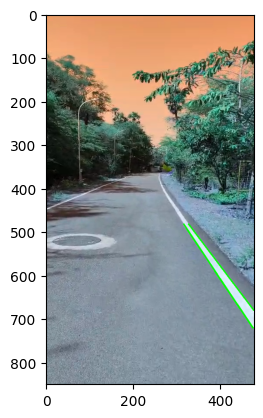

26538


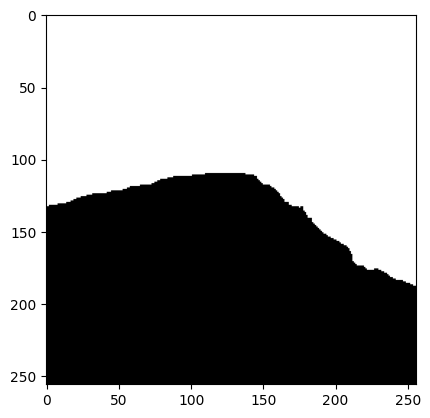

KeyboardInterrupt: 

In [57]:
process_video("test4.mp4")

In [ ]:
# def process_video(input_path, output_path):


#     """Reads a video, processes each frame, and saves the output video in MP4 format."""
    
#     # Open the input video
#     cap = cv2.VideoCapture(input_path)
#     if not cap.isOpened():
#         print("Error: Could not open input video.")
#         return
    
#     # Get video properties
#     frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
#     frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
#     fps = cap.get(cv2.CAP_PROP_FPS)  

#     # Ensure FPS is valid
#     if fps <= 0 or fps is None:
#         fps = 30  # Default to 30 FPS if not detected

#     # Define the codec and create VideoWriter object (H.264 encoding for MP4)
#     fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Try 'mp4v' instead of 'avc1'
#     out = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))


#     print(f"Processing video: {input_path}")
#     print(f"Output will be saved as: {output_path} (FPS: {fps}, Resolution: {frame_width}x{frame_height})")

#     frame_count = 0

#     while cap.isOpened():
#         ret, frame = cap.read()
#         if not ret:
#             print(f"Processed {frame_count} frames. End of video reached.")
#             break  # Stop when video ends

#         # 🔹 Try processing the frame
#         try:
#             processed_frame = process_frame(frame)  # Apply processing if possible
#             if processed_frame is None:
#                 print(f"Warning: Processed frame is None at frame {frame_count}. Writing original frame instead.")
#                 processed_frame = frame  # Use the original frame if processing fails

#         except Exception as e:
#             print(f"Error processing frame {frame_count}: {e}. Writing original frame instead.")
#             processed_frame = frame  # Use the original frame if processing crashes

#         out.write(processed_frame)  # Write frame to output
#         frame_count += 1

#     cap.release()
#     out.release()

#     print("Processing complete. Video saved.")

#     # Handle GUI-related OpenCV issues
#     try:
#         cv2.destroyAllWindows()
#     except cv2.error:
#         print("Skipping cv2.destroyAllWindows() due to missing GUI support.")

#     # Process video frame by frame
#     frame_count = 0
#     while True:
#         ret, frame = cap.read()
#         if not ret:
#             print("End of video reached or error reading frame.")
#             break

#         processed_frame = process_frame(frame)  # Apply processing
#         out.write(processed_frame)  # Save processed frame
        
#         frame_count += 1
#         if frame_count % 50 == 0:
#             print(f"Processed {frame_count} frames...")

#     # Release resources
#     cap.release()
#     out.release()
#     cv2.destroyAllWindows()
    
#     print("✅ Video processing complete!")
